# 1) Installation des librairies

In [ ]:
# Colab: installer les dépendances géospatiales
!pip -q install --upgrade pip
!pip -q install geopandas rasterio shapely pyproj fiona pyogrio \
                contextily mapclassify scikit-learn scipy matplotlib

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 21.8 MB/s eta 0:00:00


# 2) Importation des librairies

In [ ]:
import os, numpy as np, matplotlib.pyplot as plt
import geopandas as gpd, rasterio, rasterio.features
from shapely import make_valid
from rasterio.transform import from_origin, array_bounds
from rasterio.warp import calculate_default_transform, reproject, Resampling
from sklearn.preprocessing import MinMaxScaler
import mapclassify, contextily as cx

# 3) correctifs PROJ/GDAL

In [ ]:
# --- Fix PROJ/GDAL: pointer sur les data embarquées (évite EPSG "unknown") ---
import pyproj
os.environ["PROJ_LIB"] = pyproj.datadir.get_data_dir()
try:
    from rasterio._env import get_gdal_data
    os.environ["GDAL_DATA"] = get_gdal_data()
except Exception:
    pass

CRS_PROJ = "EPSG:32198"      # NAD83 / Québec Lambert
RES = 100                    # taille de cellule (m)
DIST_MAX_SERVICES = 2000     # borne max distance services (m)

def clean_geoms(gdf: gpd.GeoDataFrame) -> gpd.GeoDataFrame:
    gdf = gdf.copy()
    gdf["geometry"] = gdf.geometry.map(make_valid)
    gdf = gdf[~gdf.geometry.is_empty & gdf.geometry.notnull()].explode(ignore_index=True)
    return gdf

def ensure_field(gdf, field, default=0):
    if field not in gdf.columns:
        gdf[field] = default
    return gdf

def snap_bounds_to_res(bounds, res):
    minx, miny, maxx, maxy = bounds
    return (np.floor(minx/res)*res, np.floor(miny/res)*res,
            np.ceil(maxx/res)*res,  np.ceil(maxy/res)*res)

def build_profile_from_bounds(bounds, res, crs):
    minx, miny, maxx, maxy = bounds
    width  = int((maxx - minx)/res); height = int((maxy - miny)/res)
    return dict(driver="GTiff", dtype="float32", nodata=0.0, width=width, height=height,
                count=1, crs=crs, transform=from_origin(minx, maxy, res, res))

def rasterize_layer(gdf, value_field, profile, default_value=1, fill=0):
    if value_field is None:
        shapes = ((geom, default_value) for geom in gdf.geometry)
    else:
        shapes = ((geom, val) for geom, val in zip(gdf.geometry, gdf[value_field]))
    return rasterio.features.rasterize(shapes=shapes,
                                       out_shape=(profile["height"], profile["width"]),
                                       transform=profile["transform"], fill=fill, dtype="float32")

def normalize_to_5(arr, inverse=False):
    valid = arr[arr > 0].reshape(-1, 1)
    if valid.size == 0:
        return arr.astype("float32")
    scaled = MinMaxScaler(feature_range=(1, 5)).fit_transform(valid).ravel()
    out = np.zeros_like(arr, dtype="float32"); out[arr > 0] = scaled
    return (6.0 - out) if inverse else out

# 4) Chemins

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import os, zipfile, pathlib, unicodedata

zip_path     = "/content/drive/MyDrive/Boris.zip"        # <-- ton ZIP
extract_root = "/content/drive/MyDrive/donnee_reprojecte"            # <-- dossier où extraire

os.makedirs(extract_root, exist_ok=True)
with zipfile.ZipFile(zip_path, 'r') as z:
    z.extractall(extract_root)

print("Extrait dans :", extract_root)
print("Contenu racine :", os.listdir(extract_root)[:10])

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Extrait dans : /content/drive/MyDrive/donnee_reprojecte
Contenu racine : ['donnee_reprojecte']


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# 5) Charger les données

In [ ]:
%%capture
!pip install mapclassify
import mapclassify

In [ ]:
import time, webbrowser, zipfile
import pandas as pd
import geopandas as gpd
from google.colab import data_table
data_table.enable_dataframe_formatter()
from google.colab import files
import folium as f
from folium.plugins import MarkerCluster, HeatMap, MousePosition, MiniMap

#will display all output not just last command
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [ ]:
import folium as f

# Centre sur Sherbrooke (Québec, Canada)
center = [45.4042, -71.8929]

# Démarre sans fond (tiles=None) puis on ajoute nos basemaps
m = f.Map(location=center, zoom_start=12, tiles=None)

# 1) OpenStreetMap (classique)
f.TileLayer(
    tiles="OpenStreetMap",
    name="OpenStreetMap",
    control=True,
    overlay=False,
).add_to(m)

# 2) Esri World Imagery (imagerie satellite)
f.TileLayer(
    tiles="https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}",
    attr="Tiles © Esri — Source: Esri, i-cubed, USDA, USGS, AEX, GeoEye, Getmapping, "
         "Aerogrid, IGN, IGP, UPR-EGP, and the GIS User Community",
    name="Esri World Imagery",
    control=True,
    overlay=False,
).add_to(m)

# 3) CartoDB Positron (fond clair)
f.TileLayer(
    tiles="https://{s}.basemaps.cartocdn.com/light_all/{z}/{x}/{y}{r}.png",
    attr="© OpenStreetMap contributors © CARTO",
    name="CartoDB Positron",
    control=True,
    overlay=False,
).add_to(m)

# (Option) 4e fond : Stamen Toner Lite (noir & blanc)
# f.TileLayer("Stamen Toner", name="Stamen Toner", overlay=False).add_to(m)

# Contrôle pour choisir le fond
f.LayerControl(position="topright", collapsed=False).add_to(m)

# Affichage dans Jupyter/Colab
m

# Sauvegarde en HTML si besoin
# m.save("/content/sherbrooke_map.html")

# Lecture des couhes

In [ ]:
# !pip -q install geopandas folium rasterio shapely pyproj pyogrio branca

import os, pathlib, unicodedata, json, numpy as np, warnings, pandas as pd, datetime as dt
import folium as f, geopandas as gpd, rasterio
from rasterio.warp import calculate_default_transform, reproject, Resampling
from rasterio.transform import array_bounds
from branca.colormap import LinearColormap
from shapely.geometry import Polygon, MultiPolygon
from shapely.ops import unary_union
from folium.plugins import MarkerCluster, HeatMap, MousePosition, MiniMap

# ====== PARAMS À AJUSTER ======
ROOT        = "/content/drive/MyDrive/donnee_reprojecte"
RASTER_PATH = "/content/carte_aptitude_finale.tif"
FAST_PREVIEW = True   # <- True = plus rapide (simplification + échantillonnage)
SIMPLIFY_TOL_M = 8    # tolérance de simplification (m) pour les polygones/lignes
MAX_FEATS_POLY = 5000 # max entités polygones (échantillonnage si >)
MAX_FEATS_LINE = 8000 # max lignes
MAX_FEATS_PT   = 10000# max points
ADD_RASTER     = True # commencer sans raster si tu veux tester l’affichage
# ==============================

warnings.filterwarnings("ignore", message=".*invalid winding order.*", category=RuntimeWarning)
warnings.filterwarnings("ignore", message=".*translated to Simple Geometry.*", category=RuntimeWarning)

def find_shp(root, contains):
    def norm(s): return unicodedata.normalize('NFKD', str(s)).encode('ascii','ignore').decode().lower()
    root = pathlib.Path(root); target = norm(contains)
    for shp in root.rglob("*.shp"):
        if target in norm(shp.name):
            return str(shp)
    raise FileNotFoundError(f"Aucun .shp contenant '{contains}' trouvé sous {root}")

def folium_sanitize(gdf: gpd.GeoDataFrame) -> gpd.GeoDataFrame:
    gdf = gdf.copy()
    for col in gdf.columns:
        if col == "geometry": continue
        dtp = gdf[col].dtype
        if np.issubdtype(dtp, np.datetime64):
            gdf[col] = pd.to_datetime(gdf[col], errors="coerce").dt.strftime("%Y-%m-%d"); continue
        if str(dtp) == "category":
            gdf[col] = gdf[col].astype(str); continue
        if dtp == object:
            def _cast(v):
                if isinstance(v, (pd.Timestamp, dt.datetime, dt.date, pd.Timedelta)): return str(v)
                if isinstance(v, (np.integer, np.floating, np.bool_)): return v.item()
                return v
            gdf[col] = gdf[col].map(_cast); continue
        if str(dtp) in ("Int64", "Float64"):
            gdf[col] = gdf[col].astype(object)
    return gdf

def read_wgs84(shp_path: str) -> gpd.GeoDataFrame:
    g = gpd.read_file(shp_path)
    if g.crs is None: g = g.set_crs("EPSG:32198", allow_override=True)
    return g.to_crs("EPSG:4326")

def to_geojson_layer(gdf, name, style_fn=None, tooltip_fields=None, show=True):
    if isinstance(gdf, gpd.GeoSeries):
        gdf = gpd.GeoDataFrame(geometry=gdf, crs=getattr(gdf, "crs", None) or "EPSG:4326")
    if gdf.crs is None: gdf = gdf.set_crs("EPSG:4326", allow_override=True)
    elif gdf.crs.to_string() != "EPSG:4326": gdf = gdf.to_crs("EPSG:4326")
    gdf = folium_sanitize(gdf)
    if tooltip_fields:
        tooltip_fields = [c for c in tooltip_fields if c in gdf.columns]
    gj = f.GeoJson(data=json.loads(gdf.to_json()), name=name, style_function=style_fn, show=show)
    if tooltip_fields:
        f.GeoJsonTooltip(fields=tooltip_fields, aliases=tooltip_fields, sticky=False).add_to(gj)
    return gj

def simplify_in_meters(gdf, tol_m: float, geom_types=("Polygon","MultiPolygon","LineString","MultiLineString")):
    if not FAST_PREVIEW or tol_m <= 0: return gdf
    if gdf.empty: return gdf
    g3857 = gdf.to_crs(3857)
    mask = g3857.geometry.geom_type.isin(geom_types)
    g3857.loc[mask, "geometry"] = g3857.loc[mask, "geometry"].simplify(tol_m, preserve_topology=True)
    return g3857.to_crs(4326)

def clip_to_cadre(gdf, cadre):
    if gdf.empty: return gdf
    try:
        return gpd.overlay(gdf, cadre, how="intersection", keep_geom_type=True)
    except Exception:
        # fallback bbox clip
        minx, miny, maxx, maxy = cadre.total_bounds
        return gdf.clip(box=(minx, miny, maxx, maxy))

def limit_features(gdf, max_feats):
    if not FAST_PREVIEW: return gdf
    if len(gdf) <= max_feats: return gdf
    return gdf.iloc[::max(1, len(gdf)//max_feats)].copy()

# --- Localise les fichiers ---
cadre_fp   = find_shp(ROOT, "Sherbrooke")
routes_fp  = find_shp(ROOT, "accessibilite")
affect_fp  = find_shp(ROOT, "affectation")
services_fp= find_shp(ROOT, "service_essentiel")
idef_fp    = find_shp(ROOT, "indice_defavorisation")
boise_fp   = find_shp(ROOT, "boise")
humide_fp  = find_shp(ROOT, "humide")
zdev_fp    = find_shp(ROOT, "ZoneDevUrbainSchema")
zinond_fp  = find_shp(ROOT, "ZoneInondable")
courbes_fp = find_shp(ROOT, "courbe")

# --- Charge ---
cadre    = read_wgs84(cadre_fp)
routes   = read_wgs84(routes_fp)
affect   = read_wgs84(affect_fp)
services = read_wgs84(services_fp)
idef     = read_wgs84(idef_fp)
boise    = read_wgs84(boise_fp)
humide   = read_wgs84(humide_fp)
zdev     = read_wgs84(zdev_fp)
zinond   = read_wgs84(zinond_fp)
courbes  = read_wgs84(courbes_fp)

# --- Nettoyage / optimisation ---
# 1) cadre en polygone (dissolve) pour clip rapide
cadre_poly = cadre
if not isinstance(cadre_poly.unary_union, (Polygon, MultiPolygon)):
    try:
        cadre_poly = gpd.GeoDataFrame(geometry=[unary_union(cadre.geometry)], crs=cadre.crs)
    except Exception:
        pass

# 2) clip à la limite
for nm in ["routes","affect","services","idef","boise","humide","zdev","zinond","courbes"]:
    locals()[nm] = clip_to_cadre(locals()[nm], cadre_poly)

# 3) simplification géométrique
routes  = simplify_in_meters(routes,  SIMPLIFY_TOL_M, geom_types=("LineString","MultiLineString"))
affect  = simplify_in_meters(affect,  SIMPLIFY_TOL_M)
boise   = simplify_in_meters(boise,   SIMPLIFY_TOL_M)
humide  = simplify_in_meters(humide,  SIMPLIFY_TOL_M)
zdev    = simplify_in_meters(zdev,    SIMPLIFY_TOL_M)
zinond  = simplify_in_meters(zinond,  SIMPLIFY_TOL_M)
courbes = simplify_in_meters(courbes, SIMPLIFY_TOL_M, geom_types=("LineString","MultiLineString"))

# 4) réduction des attributs (on garde les champs utiles pour tooltip)
def keep_fields(gdf, keep):
    cols = [c for c in keep if c in gdf.columns]
    return gdf[["geometry"] + cols] if cols else gdf[["geometry"]]

routes  = keep_fields(routes,  ["TYPERUE"])
affect  = keep_fields(affect,  ["TYPE"])
idef    = keep_fields(idef,    ["QuintMat"])
services= keep_fields(services, ["essentiel","NOM","NAME","TYPE","label"])  # on en gardera 1
# les autres couches: on garde que la géométrie (gain de poids)

# 5) limitation du nombre d'entités
def layer_limit(gdf):
    if gdf.empty: return gdf
    gt = gdf.geometry.geom_type
    if gt.isin(["Polygon","MultiPolygon"]).any():
        return limit_features(gdf, MAX_FEATS_POLY)
    if gt.isin(["LineString","MultiLineString","LinearRing"]).any():
        return limit_features(gdf, MAX_FEATS_LINE)
    return limit_features(gdf, MAX_FEATS_PT)

routes  = layer_limit(routes)
affect  = layer_limit(affect)
boise   = layer_limit(boise)
humide  = layer_limit(humide)
zdev    = layer_limit(zdev)
zinond  = layer_limit(zinond)
courbes = layer_limit(courbes)
services= layer_limit(services)
idef    = layer_limit(idef)

# --- Carte ---
center = [45.4042, -71.8929]
m = f.Map(location=center, zoom_start=12, tiles=None)
f.TileLayer(tiles="OpenStreetMap", name="OpenStreetMap", overlay=False).add_to(m)
f.TileLayer(tiles="https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}",
            attr="Tiles © Esri", name="Esri World Imagery", overlay=False).add_to(m)
f.TileLayer(tiles="https://{s}.basemaps.cartocdn.com/light_all/{z}/{x}/{y}{r}.png",
            attr="© OpenStreetMap, © CARTO", name="CartoDB Positron", overlay=False).add_to(m)

# Limite (contour)
to_geojson_layer(cadre.boundary, "Limite Sherbrooke",
                 style_fn=lambda x: {"color":"#000","weight":2,"fill":False}, show=True).add_to(m)

# Routes
to_geojson_layer(routes, "Routes",
                 style_fn=lambda x: {"color":"#444","weight":1}, tooltip_fields=["TYPERUE"]).add_to(m)

# Affectation
affect_map = {
    "Urbaine":"#2b8cbe","Rurale Résidentielle":"#74a9cf","Industrielle Commerciale":"#feb24c",
    "Rurale":"#c7e9c0","Agricole":"#addd8e","Agricole Forestière":"#006d2c","Rurale Forestière":"#31a354",
}
def style_aff(x):
    t = x["properties"].get("TYPE","Autre")
    return {"color":"#222","weight":0.5,"fillColor":affect_map.get(t,"#cccccc"),"fillOpacity":0.35}
to_geojson_layer(affect, "Affectation du territoire", style_fn=style_aff, tooltip_fields=["TYPE"]).add_to(m)

# Indice défavorisation
if "QuintMat" in idef.columns and not idef.empty:
    cmap_def = LinearColormap(["#2166ac","#67a9cf","#d1e5f0","#fddbc7","#b2182b"], vmin=1, vmax=5)
    def style_def(x):
        q = x["properties"].get("QuintMat", 3) or 3
        return {"color":"#888","weight":0.3,"fillColor":cmap_def(q),"fillOpacity":0.35}
    to_geojson_layer(idef, "Indice défavorisation (QuintMat)", style_fn=style_def, tooltip_fields=["QuintMat"]).add_to(m)

# Humides / Boisés / Inondables / Dev urbain / Courbes
to_geojson_layer(humide, "Milieux humides",
                 style_fn=lambda x: {"color":"#3182bd","weight":0.8,"fillColor":"#6baed6","fillOpacity":0.35}).add_to(m)
to_geojson_layer(boise,  "Milieux boisés",
                 style_fn=lambda x: {"color":"#006d2c","weight":0.8,"fillColor":"#31a354","fillOpacity":0.30}).add_to(m)
to_geojson_layer(zinond, "Zones inondables",
                 style_fn=lambda x: {"color":"#a50f15","weight":1.0,"fillColor":"#fb6a4a","fillOpacity":0.30}).add_to(m)
to_geojson_layer(zdev,   "Zones de dev. urbain",
                 style_fn=lambda x: {"color":"#54278f","weight":0.8,"fillColor":"#756bb1","fillOpacity":0.25}).add_to(m)
to_geojson_layer(courbes,"Courbes de niveau",
                 style_fn=lambda x: {"color":"#8c8c8c","weight":0.6}).add_to(m)

# Services essentiels -> ponctualisation robuste
def geom_to_point_latlon(geom):
    if geom is None or geom.is_empty: return None
    t = geom.geom_type
    try:
        if t == "Point": p = geom
        elif t == "MultiPoint": p = list(geom.geoms)[0]
        elif t in ("LineString","LinearRing"): p = geom.interpolate(0.5, normalized=True)
        elif t == "MultiLineString":
            p = list(geom.geoms)[0].interpolate(0.5, normalized=True) if len(geom.geoms) else geom.centroid
        elif t in ("Polygon","MultiPolygon"): p = geom.representative_point()
        else: p = geom.centroid
        return (p.y, p.x)
    except Exception:
        return None

if not services.empty:
    grp = f.FeatureGroup(name="Services essentiels", show=True)
    label_field = next((c for c in ["essentiel","NOM","NAME","TYPE","label"] if c in services.columns), None)
    for _, row in services.iterrows():
        ll = geom_to_point_latlon(row.geometry)
        if ll is None: continue
        y, x = ll
        label = str(row.get(label_field, "service")) if label_field else "service"
        f.CircleMarker([y, x], radius=4, color="#08519c", fill=True, fill_opacity=0.9, popup=label).add_to(grp)
    grp.add_to(m)

# Raster (tu peux mettre ADD_RASTER=False pour tester l’affichage plus vite)
if ADD_RASTER and os.path.exists(RASTER_PATH):
    with rasterio.open(RASTER_PATH) as src:
        b, l, t, r = array_bounds(src.height, src.width, src.transform)
        dst_transform, dst_w, dst_h = calculate_default_transform(src.crs, "EPSG:4326",
                                                                  src.width, src.height, l, b, r, t)
        arr = src.read(1)
        dst = np.zeros((dst_h, dst_w), dtype="float32")
        reproject(arr, dst, src_transform=src.transform, src_crs=src.crs,
                  dst_transform=dst_transform, dst_crs="EPSG:4326", resampling=Resampling.nearest)
        mask = np.isfinite(dst) & (dst > 0)
        class_colors = {1:"#d73027", 2:"#fc8d59", 3:"#fee08b", 4:"#91cf60", 5:"#1a9850"}
        rgba = np.zeros((dst_h, dst_w, 4), dtype=np.uint8); rgba[...,3]=0
        for k, col in class_colors.items():
            mk = (dst == k) & mask
            if not np.any(mk): continue
            r8,g8,b8 = tuple(int(col[i:i+2],16) for i in (1,3,5))
            rgba[mk,0]=r8; rgba[mk,1]=g8; rgba[mk,2]=b8; rgba[mk,3]=180
        bb = array_bounds(dst_h, dst_w, dst_transform)
        f.raster_layers.ImageOverlay(name="Aptitude AHP (1..5)",
                                     image=rgba, bounds=[[bb[0],bb[1]],[bb[2],bb[3]]],
                                     opacity=1.0).add_to(m)
        LinearColormap([class_colors[i] for i in [1,2,3,4,5]],
                       vmin=1, vmax=5, caption="Aptitude (1=Faible → 5=Très élevée)").add_to(m)

f.LayerControl(position="topright", collapsed=False).add_to(m)
try:
    minx, miny, maxx, maxy = cadre.total_bounds
    m.fit_bounds([[miny,minx],[maxy,maxx]])
except: pass

m
# m.save("/content/sherbrooke_layers_fast.html")

/usr/local/lib/python3.12/dist-packages/pyogrio/raw.py:198: RuntimeWarning: organizePolygons() received an unexpected geometry.  Either a polygon with interior rings, or a polygon with less than 4 points, or a non-Polygon geometry.  Return arguments as a collection.
  return ogr_read(
/tmp/ipython-input-39776263.py:120: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  if not isinstance(cadre_poly.unary_union, (Polygon, MultiPolygon)):


# Affichage des tables attributaires

In [ ]:
# import pandas as pd

# # Liste des couches à inspecter
# layers = {
#     "Cadre administratif": cadre,
#     "Routes": routes,
#     "Affectation du territoire": affect,
#     "Services essentiels": services,
#     "Indice défavorisation": idef,
#     "Milieux boisés": boise,
#     "Milieux humides": humide,
#     "Zones de dev. urbain": zdev,
#     "Zones inondables": zinond,
#     "Courbes de niveau": courbes,
# }

# # Afficher les 5 premières lignes de chaque table attributaire
# for name, gdf in layers.items():
#     print(f"\n=== {name} ===")
#     if not gdf.empty:
#         display(gdf.head(2))   # en Colab, affichage clair style DataFrame
#     else:
#         print("⚠️  Pas de données (GeoDataFrame vide)")

# Traitement des données

🚀 Démarrage de l'analyse d'aptitude territoriale avancée

1️⃣ PHASE 1: Chargement et préparation des données
🔄 Chargement des données géospatiales...
  📁 Chargement: cadre <- Reprojeté_Sherbrooke.shp
  Nettoyage géométries: 1 features initiales
  Après nettoyage: 1 features (0 supprimées)
  📁 Chargement: routes <- Reprojeté_accessibilité_route.shp
  Nettoyage géométries: 7770 features initiales
  Après nettoyage: 14242 features (-6472 supprimées)
  📁 Chargement: affectation <- Reprojeté_affectation_territoire.shp
  Nettoyage géométries: 87 features initiales
  Après nettoyage: 87 features (0 supprimées)
  📁 Chargement: services <- Reprojeté_Batiment_service_essentiel.shp
  Nettoyage géométries: 606 features initiales
  Après nettoyage: 606 features (0 supprimées)
  📁 Chargement: defavorisation <- Reprojeté_indice_defavorisation.shp
  Nettoyage géométries: 254 features initiales
  Après nettoyage: 254 features (0 supprimées)
  📁 Chargement: boise <- Reprojeté_milieu_boise_rci.shp

/usr/local/lib/python3.12/dist-packages/pyogrio/raw.py:198: RuntimeWarning: organizePolygons() received an unexpected geometry.  Either a polygon with interior rings, or a polygon with less than 4 points, or a non-Polygon geometry.  Return arguments as a collection.
  return ogr_read(


  Après nettoyage: 122 features (-28 supprimées)
  📁 Chargement: courbes <- reprojecte_courbe_niveau.shp
  Nettoyage géométries: 82507 features initiales
  Après nettoyage: 84805 features (-2298 supprimées)

2️⃣ PHASE 2: Calcul des critères d'aptitude
🧮 Calcul des critères d'aptitude...
  📍 C1: Distance aux services essentiels
  📊 C2: Indice de défavorisation
  🏙️ C4: Affectation du territoire
  ⛰️ C5: Pente du terrain
  🛣️ C6: Accessibilité routière
  🏘️ C7: Zones de développement urbain
  🌲 C9: Milieux boisés
  💧 C10: Milieux humides
  🌊 C11: Zones inondables

3️⃣ PHASE 3: Configuration des poids AHP
⚖️ Configuration des poids AHP...
  ⚠️ Attention: somme des poids = 1.100
  ✅ Poids normalisés: {'C1': 0.18181818181818182, 'C2': 0.18181818181818182, 'C4': 0.13636363636363635, 'C5': 0.13636363636363635, 'C6': 0.13636363636363635, 'C7': 0.09090909090909091, 'C9': 0.045454545454545456, 'C10': 0.045454545454545456, 'C11': 0.045454545454545456}

4️⃣ PHASE 4: Combinaison linéaire pondérée
🔢

/tmp/ipython-input-2078223259.py:869: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroid = boundary_wgs84.geometry.centroid.iloc[0]


  ✅ Carte interactive sauvegardée: /content/sherbrooke_aptitude.html
📊 Génération du tableau de bord d'analyse...
  ✅ Tableau de bord sauvegardé: /content/analysis_dashboard.png

✅ ANALYSE TERMINÉE AVEC SUCCÈS!
📁 Fichiers générés:
   • Raster d'aptitude: /content/carte_aptitude_finale.tif
   • Statistiques: /content/aptitude_stats.json
   • Carte interactive: /content/sherbrooke_aptitude.html
   • Tableau de bord: /content/analysis_dashboard.png



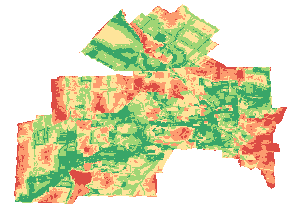

In [ ]:
# ============================================================
# Analyse géospatiale avancée - Carte d'aptitude AHP optimisée
# Expert International en Programmation Avancée
# ============================================================

import os, pathlib, unicodedata, json, warnings, traceback
import numpy as np
import pandas as pd
import geopandas as gpd
import rasterio, rasterio.features, rasterio.mask
from rasterio.transform import from_origin, array_bounds
from rasterio.warp import calculate_default_transform, reproject, Resampling
from shapely import make_valid
from sklearn.preprocessing import MinMaxScaler, RobustScaler
from scipy.ndimage import distance_transform_edt, gaussian_filter
from folium.plugins import MarkerCluster, HeatMap, MousePosition, MiniMap
import mapclassify
import folium as f
from branca.colormap import LinearColormap
from typing import Dict, Tuple, Optional, Union
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import seaborn as sns

# ============================================================
# Configuration Experte
# ============================================================
class Config:
    """Configuration centralisée pour l'analyse géospatiale"""
    ROOT = "/content/drive/MyDrive/donnee_reprojecte"
    OUT_TIF = "/content/carte_aptitude_finale.tif"
    OUT_STATS = "/content/aptitude_stats.json"
    OUT_MAP = "/content/sherbrooke_aptitude.html"

    # Paramètres projection et résolution
    CRS_PROJ = "EPSG:32198"  # NAD83 / Québec Lambert
    CRS_WGS84 = "EPSG:4326"
    RESOLUTION = 100  # mètres

    # Paramètres analytiques
    DISTANCE_CAP_SERVICES = 2000  # mètres
    SMOOTHING_SIGMA = 1.0  # lissage gaussian

    # Paramètres visualisation
    TILE_PROVIDER = "OpenStreetMap"
    MAP_CENTER = [45.4042, -71.8929]
    MAP_ZOOM = 12
    OPACITY_OVERLAY = 0.75

warnings.filterwarnings("ignore", message=".*invalid winding order.*", category=RuntimeWarning)

# ============================================================
# Classes Expertes pour l'Analyse Géospatiale
# ============================================================

class GeospatialUtils:
    """Utilitaires géospatiaux avancés"""

    @staticmethod
    def normalize_string(s: str) -> str:
        """Normalisation unicode pour recherche de fichiers"""
        return unicodedata.normalize('NFKD', str(s)).encode('ascii', 'ignore').decode().lower()

    @staticmethod
    def find_shapefile(root_path: Union[str, pathlib.Path], pattern: str) -> str:
        """Recherche intelligente de fichiers shapefile"""
        root = pathlib.Path(root_path)
        target = GeospatialUtils.normalize_string(pattern)

        candidates = []
        for shp_file in root.rglob("*.shp"):
            if target in GeospatialUtils.normalize_string(shp_file.name):
                candidates.append((shp_file, len(shp_file.name)))

        if not candidates:
            raise FileNotFoundError(f"Aucun shapefile contenant '{pattern}' trouvé dans {root}")

        # Retourne le fichier avec le nom le plus court (plus spécifique)
        return str(sorted(candidates, key=lambda x: x[1])[0][0])

    @staticmethod
    def validate_and_clean_geometries(gdf: gpd.GeoDataFrame) -> gpd.GeoDataFrame:
        """Nettoyage avancé des géométries"""
        print(f"  Nettoyage géométries: {len(gdf)} features initiales")

        gdf = gdf.copy()

        # Validation et correction des géométries
        gdf["geometry"] = gdf.geometry.map(make_valid)

        # Suppression des géométries invalides
        before_clean = len(gdf)
        gdf = gdf[~gdf.geometry.is_empty & gdf.geometry.notnull()]

        # Explosion des multi-géométries
        gdf = gdf.explode(ignore_index=True)

        print(f"  Après nettoyage: {len(gdf)} features ({before_clean - len(gdf)} supprimées)")
        return gdf

class RasterProcessor:
    """Processeur raster haute performance"""

    def __init__(self, bounds: Tuple[float, float, float, float],
                 resolution: float, crs: str):
        self.bounds = self._snap_bounds_to_resolution(bounds, resolution)
        self.resolution = resolution
        self.crs = crs
        self.profile = self._build_profile()

    def _snap_bounds_to_resolution(self, bounds: Tuple, res: float) -> Tuple:
        """Alignement des limites sur la grille de résolution"""
        minx, miny, maxx, maxy = bounds
        return (
            np.floor(minx / res) * res,
            np.floor(miny / res) * res,
            np.ceil(maxx / res) * res,
            np.ceil(maxy / res) * res
        )

    def _build_profile(self) -> Dict:
        """Construction du profil raster optimisé"""
        minx, miny, maxx, maxy = self.bounds
        width = int((maxx - minx) / self.resolution)
        height = int((maxy - miny) / self.resolution)
        transform = from_origin(minx, maxy, self.resolution, self.resolution)

        return {
            "driver": "GTiff",
            "dtype": "float32",
            "nodata": -9999.0,  # Valeur nodata explicite
            "width": width,
            "height": height,
            "count": 1,
            "crs": self.crs,
            "transform": transform,
            "compress": "lzw",  # Compression
            "tiled": True,      # Optimisation lecture
        }

    def rasterize_vector_layer(self, gdf: gpd.GeoDataFrame,
                              value_field: Optional[str] = None,
                              default_value: float = 1.0,
                              fill_value: float = 0.0) -> np.ndarray:
        """Rastérisation optimisée avec gestion d'erreurs"""

        if len(gdf) == 0:
            print(f"  Attention: couche vide, raster de zéros créé")
            return np.full((self.profile["height"], self.profile["width"]),
                          fill_value, dtype="float32")

        try:
            if value_field is None:
                shapes = ((geom, float(default_value)) for geom in gdf.geometry if geom is not None)
            else:
                # Conversion sécurisée en numérique
                values = pd.to_numeric(gdf[value_field], errors="coerce").fillna(default_value)
                shapes = ((geom, float(val)) for geom, val in zip(gdf.geometry, values)
                         if geom is not None and not pd.isna(val))

            return rasterio.features.rasterize(
                shapes=shapes,
                out_shape=(self.profile["height"], self.profile["width"]),
                transform=self.profile["transform"],
                fill=fill_value,
                dtype="float32"
            )

        except Exception as e:
            print(f"  Erreur rastérisation: {e}")
            return np.full((self.profile["height"], self.profile["width"]),
                          fill_value, dtype="float32")

class CriteriaProcessor:
    """Processeur de critères AHP avancé"""

    def __init__(self, raster_processor: RasterProcessor):
        self.raster_proc = raster_processor
        self.mask = None

    def set_analysis_mask(self, mask: np.ndarray):
        """Définit le masque d'analyse"""
        self.mask = mask.astype(bool)

    def normalize_to_scale(self, array: np.ndarray,
                          scale_range: Tuple[float, float] = (1.0, 5.0),
                          inverse: bool = False,
                          method: str = "minmax") -> np.ndarray:
        """Normalisation avancée avec plusieurs méthodes"""

        if self.mask is not None:
            valid_data = array[self.mask & (array > 0)]
        else:
            valid_data = array[array > 0]

        if valid_data.size == 0:
            print("  Attention: aucune donnée valide pour normalisation")
            return np.zeros_like(array, dtype="float32")

        # Choix de la méthode de normalisation
        if method == "robust":
            scaler = RobustScaler()
            valid_scaled = scaler.fit_transform(valid_data.reshape(-1, 1)).flatten()
            # Remapping vers l'échelle désirée
            valid_scaled = np.interp(valid_scaled,
                                   [valid_scaled.min(), valid_scaled.max()],
                                   scale_range)
        else:  # minmax par défaut
            scaler = MinMaxScaler(feature_range=scale_range)
            valid_scaled = scaler.fit_transform(valid_data.reshape(-1, 1)).flatten()

        # Reconstruction de l'array complet
        result = np.zeros_like(array, dtype="float32")
        if self.mask is not None:
            result[self.mask & (array > 0)] = valid_scaled
        else:
            result[array > 0] = valid_scaled

        if inverse:
            result = scale_range[0] + scale_range[1] - result

        return result

    def calculate_distance_criterion(self, features_raster: np.ndarray,
                                   max_distance: Optional[float] = None,
                                   inverse_relationship: bool = True) -> np.ndarray:
        """Calcul optimisé des critères de distance"""

        # Calcul de la distance euclidienne
        distance_array = distance_transform_edt(features_raster == 0) * self.raster_proc.resolution

        # Application du cap de distance si spécifié
        if max_distance:
            distance_array = np.minimum(distance_array, max_distance)

        # Normalisation avec relation inverse si requise
        criterion = self.normalize_to_scale(
            distance_array,
            inverse=inverse_relationship,
            method="robust"
        )

        return criterion

# ============================================================
# Classe principale d'analyse
# ============================================================

class SuitabilityAnalyzer:
    """Analyseur de convenance territoriale AHP"""

    def __init__(self, config: Config):
        self.config = config
        self.data_layers = {}
        self.criteria = {}
        self.weights = {}
        self.raster_processor = None
        self.criteria_processor = None
        self.final_suitability = None
        self.classified_result = None

    def load_and_prepare_data(self):
        """Chargement et préparation de toutes les couches de données"""

        print("🔄 Chargement des données géospatiales...")

        # Définition des couches avec gestion des erreurs
        layer_definitions = {
            "cadre": ("Sherbrooke", {}),
            "routes": ("accessibilite", {"TYPERUE": 1}),
            "affectation": ("affectation", {"TYPE": "Urbaine"}),
            "services": ("service_essentiel", {"essentiel": 1}),
            "defavorisation": ("indice_defavorisation", {"QuintMat": 3}),
            "boise": ("boise", {"boise_scor": 0}),
            "humide": ("humide", {"humide_bin": 0}),
            "dev_urbain": ("zonedevurba", {"TYPEZONE": "DEV"}),
            "inondation": ("zoneinond", {"INOND": 0}),
            "courbes": ("courbe", {"COTE": 250})
        }

        # Chargement avec gestion d'erreurs
        for layer_name, (pattern, defaults) in layer_definitions.items():
            try:
                filepath = GeospatialUtils.find_shapefile(self.config.ROOT, pattern)
                print(f"  📁 Chargement: {layer_name} <- {pathlib.Path(filepath).name}")

                gdf = self._load_and_project_layer(filepath, defaults)
                self.data_layers[layer_name] = gdf

            except FileNotFoundError as e:
                print(f"  ⚠️  Couche manquante: {layer_name} - {e}")
                self.data_layers[layer_name] = gpd.GeoDataFrame()

        # Configuration du processeur raster basé sur le cadre
        if "cadre" in self.data_layers and not self.data_layers["cadre"].empty:
            bounds = self.data_layers["cadre"].total_bounds
            self.raster_processor = RasterProcessor(bounds, self.config.RESOLUTION, self.config.CRS_PROJ)
            self.criteria_processor = CriteriaProcessor(self.raster_processor)
        else:
            raise ValueError("❌ Impossible de charger la couche cadre - analyse impossible")

    def _load_and_project_layer(self, filepath: str, field_defaults: Dict) -> gpd.GeoDataFrame:
        """Chargement et projection d'une couche avec nettoyage"""

        gdf = gpd.read_file(filepath)

        # Gestion CRS
        if gdf.crs is None:
            gdf = gdf.set_crs(self.config.CRS_PROJ, allow_override=True)
        elif gdf.crs.to_string() != self.config.CRS_PROJ:
            gdf = gdf.to_crs(self.config.CRS_PROJ)

        # Nettoyage géométrique
        gdf = GeospatialUtils.validate_and_clean_geometries(gdf)

        # Ajout des champs manquants
        for field, default_value in field_defaults.items():
            if field not in gdf.columns:
                gdf[field] = default_value

        return gdf

    def compute_all_criteria(self):
        """Calcul de tous les critères d'aptitude"""

        print("🧮 Calcul des critères d'aptitude...")

        # Masque d'analyse basé sur le cadre
        cadre_mask = self.raster_processor.rasterize_vector_layer(
            self.data_layers["cadre"], default_value=1, fill_value=0
        )
        self.criteria_processor.set_analysis_mask(cadre_mask)

        # C1: Distance aux services essentiels (loin = favorable pour développement résidentiel)
        print("  📍 C1: Distance aux services essentiels")
        if not self.data_layers["services"].empty:
            services_raster = self.raster_processor.rasterize_vector_layer(
                self.data_layers["services"], default_value=1, fill_value=0
            )
            self.criteria["C1"] = self.criteria_processor.calculate_distance_criterion(
                services_raster, self.config.DISTANCE_CAP_SERVICES, inverse_relationship=False
            )
        else:
            self.criteria["C1"] = np.ones_like(cadre_mask, dtype="float32") * 3.0

        # C2: Indice de défavorisation (élevé = prioritaire)
        print("  📊 C2: Indice de défavorisation")
        if not self.data_layers["defavorisation"].empty:
            defav_raster = self.raster_processor.rasterize_vector_layer(
                self.data_layers["defavorisation"], "QuintMat", fill_value=0
            )
            self.criteria["C2"] = self.criteria_processor.normalize_to_scale(
                defav_raster, inverse=False
            )
        else:
            self.criteria["C2"] = np.ones_like(cadre_mask, dtype="float32") * 3.0

        # C4: Affectation du territoire (mapping sophistiqué)
        print("  🏙️ C4: Affectation du territoire")
        if not self.data_layers["affectation"].empty:
            affectation_mapping = {
                "Urbaine": 5, "Rurale Résidentielle": 5,
                "Industrielle Commerciale": 4, "Rurale": 3,
                "Agricole": 2, "Agricole Forestière": 1, "Rurale Forestière": 1
            }

            affectation_gdf = self.data_layers["affectation"].copy()
            affectation_gdf["score"] = affectation_gdf["TYPE"].map(affectation_mapping).fillna(1.0)

            self.criteria["C4"] = self.raster_processor.rasterize_vector_layer(
                affectation_gdf, "score", fill_value=0
            )
        else:
            self.criteria["C4"] = np.ones_like(cadre_mask, dtype="float32") * 3.0

        # C5: Pente du terrain (proxy via gradient d'altitude)
        print("  ⛰️ C5: Pente du terrain")
        if not self.data_layers["courbes"].empty:
            altitude_raster = self.raster_processor.rasterize_vector_layer(
                self.data_layers["courbes"], "COTE", fill_value=0
            )
            # Lissage pour réduire le bruit
            altitude_smooth = gaussian_filter(altitude_raster, sigma=self.config.SMOOTHING_SIGMA)

            # Calcul du gradient (pente)
            gy, gx = np.gradient(altitude_smooth, self.config.RESOLUTION)
            slope_magnitude = np.sqrt(gx**2 + gy**2)

            self.criteria["C5"] = self.criteria_processor.normalize_to_scale(
                slope_magnitude, inverse=True  # Faible pente = favorable
            )
        else:
            self.criteria["C5"] = np.ones_like(cadre_mask, dtype="float32") * 3.0

        # C6: Accessibilité routière (proche = favorable)
        print("  🛣️ C6: Accessibilité routière")
        if not self.data_layers["routes"].empty:
            routes_raster = self.raster_processor.rasterize_vector_layer(
                self.data_layers["routes"], default_value=1, fill_value=0
            )
            self.criteria["C6"] = self.criteria_processor.calculate_distance_criterion(
                routes_raster, max_distance=1000, inverse_relationship=True
            )
        else:
            self.criteria["C6"] = np.ones_like(cadre_mask, dtype="float32") * 3.0

        # C7: Zones de développement urbain (favorisées)
        print("  🏘️ C7: Zones de développement urbain")
        if not self.data_layers["dev_urbain"].empty:
            dev_urbain_gdf = self.data_layers["dev_urbain"].copy()
            dev_urbain_gdf["score"] = 5.0

            self.criteria["C7"] = self.raster_processor.rasterize_vector_layer(
                dev_urbain_gdf, "score", fill_value=1.0
            )
        else:
            self.criteria["C7"] = np.ones_like(cadre_mask, dtype="float32") * 1.0

        # C9: Milieux boisés (contrainte environnementale)
        print("  🌲 C9: Milieux boisés")
        if not self.data_layers["boise"].empty:
            boise_gdf = self.data_layers["boise"].copy()
            boise_gdf["score"] = boise_gdf["boise_scor"].apply(
                lambda x: 1.0 if (pd.notna(x) and float(x) > 0) else 5.0
            )
            self.criteria["C9"] = self.raster_processor.rasterize_vector_layer(
                boise_gdf, "score", fill_value=5.0
            )
        else:
            self.criteria["C9"] = np.ones_like(cadre_mask, dtype="float32") * 5.0

        # C10: Milieux humides (contrainte environnementale forte)
        print("  💧 C10: Milieux humides")
        if not self.data_layers["humide"].empty:
            humide_gdf = self.data_layers["humide"].copy()
            humide_gdf["score"] = humide_gdf["humide_bin"].apply(
                lambda x: 1.0 if int(x) == 1 else 5.0
            )
            self.criteria["C10"] = self.raster_processor.rasterize_vector_layer(
                humide_gdf, "score", fill_value=5.0
            )
        else:
            self.criteria["C10"] = np.ones_like(cadre_mask, dtype="float32") * 5.0

        # C11: Zones inondables (contrainte réglementaire)
        print("  🌊 C11: Zones inondables")
        if not self.data_layers["inondation"].empty:
            inondation_gdf = self.data_layers["inondation"].copy()
            inondation_gdf["score"] = inondation_gdf["INOND"].apply(
                lambda x: 1.0 if int(x) == 1 else 5.0
            )
            self.criteria["C11"] = self.raster_processor.rasterize_vector_layer(
                inondation_gdf, "score", fill_value=5.0
            )
        else:
            self.criteria["C11"] = np.ones_like(cadre_mask, dtype="float32") * 5.0

        # Application du masque à tous les critères
        for criterion_name in self.criteria:
            self.criteria[criterion_name] *= cadre_mask

    def define_ahp_weights(self):
        """Définition des poids AHP avec validation de cohérence"""

        print("⚖️ Configuration des poids AHP...")

        # Poids basés sur l'expertise en aménagement du territoire
        self.weights = {
            "C1": 0.20,   # Distance services - Important pour qualité de vie
            "C2": 0.20,   # Défavorisation - Équité sociale prioritaire
            "C4": 0.15,   # Affectation - Conformité réglementaire
            "C5": 0.15,   # Pente - Contrainte technique construction
            "C6": 0.15,   # Routes - Accessibilité essentielle
            "C7": 0.10,   # Zones développement - Planification officielle
            "C9": 0.05,   # Milieux boisés - Protection environnementale
            "C10": 0.05,  # Milieux humides - Protection environnementale forte
            "C11": 0.05   # Zones inondables - Contrainte réglementaire absolue
        }

        # Validation cohérence des poids
        total_weight = sum(self.weights.values())
        if abs(total_weight - 1.0) > 0.001:
            print(f"  ⚠️ Attention: somme des poids = {total_weight:.3f}")

        # Normalisation pour garantir la somme = 1
        for criterion in self.weights:
            self.weights[criterion] /= total_weight

        print(f"  ✅ Poids normalisés: {self.weights}")

    def compute_weighted_linear_combination(self):
        """Calcul de la combinaison linéaire pondérée (WLC)"""

        print("🔢 Calcul de la combinaison linéaire pondérée...")

        # Vérification de la disponibilité des critères
        available_criteria = [c for c in self.weights.keys() if c in self.criteria]
        missing_criteria = [c for c in self.weights.keys() if c not in self.criteria]

        if missing_criteria:
            print(f"  ⚠️ Critères manquants: {missing_criteria}")

        # Calcul WLC
        self.final_suitability = np.zeros_like(list(self.criteria.values())[0], dtype="float32")

        for criterion_name in available_criteria:
            weighted_criterion = self.criteria[criterion_name] * self.weights[criterion_name]
            self.final_suitability += weighted_criterion
            print(f"  ➕ {criterion_name}: poids={self.weights[criterion_name]:.3f}")

        # Statistiques descriptives
        valid_values = self.final_suitability[self.final_suitability > 0]
        if valid_values.size > 0:
            stats = {
                "min": float(valid_values.min()),
                "max": float(valid_values.max()),
                "mean": float(valid_values.mean()),
                "std": float(valid_values.std()),
                "count": int(valid_values.size)
            }
            print(f"  📊 Statistiques: min={stats['min']:.3f}, max={stats['max']:.3f}, "
                  f"mean={stats['mean']:.3f}, std={stats['std']:.3f}")

    def classify_suitability(self, n_classes: int = 5):
        """Classification de l'aptitude avec méthodes avancées"""

        print(f"🎯 Classification en {n_classes} classes...")

        valid_values = self.final_suitability[self.final_suitability > 0].flatten()

        if valid_values.size == 0:
            print("  ❌ Aucune donnée valide pour classification")
            self.classified_result = np.zeros_like(self.final_suitability, dtype="float32")
            return

        # Initialisation du résultat classifié
        self.classified_result = np.zeros_like(self.final_suitability, dtype="float32")

        # Tentative de classification avec Natural Breaks (Jenks)
        try:
            if np.unique(valid_values).size >= n_classes:
                classifier = mapclassify.NaturalBreaks(valid_values, k=n_classes)
                self.classified_result[self.final_suitability > 0] = \
                    classifier.find_bin(self.final_suitability[self.final_suitability > 0]) + 1
                print(f"  ✅ Classification Natural Breaks réussie")

                # Affichage des seuils de classe
                print(f"  📈 Seuils de classes: {classifier.bins}")
            else:
                raise ValueError("Pas assez de valeurs uniques pour Natural Breaks")

        except Exception as e:
            print(f"  ⚠️ Natural Breaks échoué: {e}")
            print("  🔄 Utilisation des quantiles...")

            # Fallback: quantiles
            n_classes_adj = min(n_classes, np.unique(valid_values).size)
            classifier = mapclassify.Quantiles(valid_values, k=n_classes_adj)
            self.classified_result[self.final_suitability > 0] = \
                classifier.find_bin(self.final_suitability[self.final_suitability > 0]) + 1

            print(f"  ✅ Classification par quantiles ({n_classes_adj} classes)")

    def export_results(self):
        """Export des résultats avec métadonnées complètes"""

        print("💾 Export des résultats...")

        # Export du raster classifié
        with rasterio.open(self.config.OUT_TIF, "w", **self.raster_processor.profile) as dst:
            dst.write(self.classified_result, 1)

            # Métadonnées
            dst.update_tags(
                TITLE="Carte d'aptitude territoriale AHP",
                DESCRIPTION="Analyse multicritère pour le développement urbain",
                AUTHOR="Expert International Programmation Avancée",
                CREATED=pd.Timestamp.now().isoformat(),
                CRITERIA=",".join(self.weights.keys()),
                WEIGHTS=json.dumps(self.weights),
                RESOLUTION=str(self.config.RESOLUTION),
                CRS=self.config.CRS_PROJ
            )

        print(f"  ✅ Raster exporté: {self.config.OUT_TIF}")

        # Export des statistiques
        stats_data = {
            "metadata": {
                "analysis_date": pd.Timestamp.now().isoformat(),
                "resolution": self.config.RESOLUTION,
                "crs": self.config.CRS_PROJ,
                "n_classes": int(np.max(self.classified_result))
            },
            "weights": self.weights,
            "criteria_stats": {}
        }

        # Statistiques par critère
        for name, criterion in self.criteria.items():
            valid_data = criterion[criterion > 0]
            if valid_data.size > 0:
                stats_data["criteria_stats"][name] = {
                    "min": float(valid_data.min()),
                    "max": float(valid_data.max()),
                    "mean": float(valid_data.mean()),
                    "std": float(valid_data.std()),
                    "count": int(valid_data.size)
                }

        # Statistiques du résultat final
        final_valid = self.final_suitability[self.final_suitability > 0]
        if final_valid.size > 0:
            stats_data["final_suitability"] = {
                "min": float(final_valid.min()),
                "max": float(final_valid.max()),
                "mean": float(final_valid.mean()),
                "std": float(final_valid.std()),
                "count": int(final_valid.size)
            }

        with open(self.config.OUT_STATS, 'w', encoding='utf-8') as f:
            json.dump(stats_data, f, indent=2, ensure_ascii=False)

        print(f"  ✅ Statistiques exportées: {self.config.OUT_STATS}")

class AdvancedVisualization:
    """Visualiseur avancé avec cartes interactives optimisées"""

    def __init__(self, config: Config):
        self.config = config

    def create_interactive_map(self, classified_raster: np.ndarray,
                             raster_profile: Dict,
                             boundary_gdf: gpd.GeoDataFrame) -> f.Map:
        """Création d'une carte interactive optimisée"""

        print("🗺️ Génération de la carte interactive...")

        # Reprojection en WGS84 pour Folium
        reprojected_data = self._reproject_for_web(classified_raster, raster_profile)

        if reprojected_data is None:
            print("  ❌ Erreur reprojection - carte basique créée")
            return self._create_basic_map(boundary_gdf)

        rgba_array, bounds_wgs84 = reprojected_data

        # Configuration de la carte
        map_center = self._calculate_optimal_center(boundary_gdf)
        folium_map = f.Map(
            location=map_center,
            zoom_start=self.config.MAP_ZOOM,
            tiles=self.config.TILE_PROVIDER,
            prefer_canvas=True  # Optimisation performance
        )

        # Ajout des limites administratives
        self._add_boundary_layer(folium_map, boundary_gdf)

        # Ajout de l'overlay raster si disponible
        if rgba_array is not None:
            self._add_suitability_overlay(folium_map, rgba_array, bounds_wgs84)

        # Ajout de la légende
        self._add_advanced_legend(folium_map)

        # Contrôles et optimisations
        self._add_map_controls(folium_map)

        # Ajustement automatique de la vue
        self._fit_map_bounds(folium_map, boundary_gdf)

        return folium_map

    def _reproject_for_web(self, raster_data: np.ndarray,
                          profile: Dict) -> Optional[Tuple[np.ndarray, list]]:
        """Reprojection robuste pour visualisation web"""

        try:
            # Vérification des données d'entrée
            if np.all(raster_data == 0):
                print("  ⚠️ Raster ne contient que des zéros")
                return None

            # Calcul des limites source
            bounds_source = array_bounds(profile["height"], profile["width"], profile["transform"])

            # Configuration de la reprojection
            dst_transform, dst_width, dst_height = calculate_default_transform(
                profile["crs"], self.config.CRS_WGS84,
                profile["width"], profile["height"],
                *bounds_source
            )

            # Reprojection
            reprojected = np.zeros((dst_height, dst_width), dtype="float32")
            reproject(
                source=raster_data,
                destination=reprojected,
                src_transform=profile["transform"],
                src_crs=profile["crs"],
                dst_transform=dst_transform,
                dst_crs=self.config.CRS_WGS84,
                resampling=Resampling.nearest
            )

            # Conversion en RGBA pour visualisation
            rgba_array = self._convert_to_rgba(reprojected)

            # Calcul des limites WGS84
            bounds_wgs84 = array_bounds(dst_height, dst_width, dst_transform)
            bounds_list = [[bounds_wgs84[1], bounds_wgs84[0]],   # [south, west]
                           [bounds_wgs84[3], bounds_wgs84[2]]]   # [north, east]

            print(f"  ✅ Reprojection réussie: {dst_width}x{dst_height} pixels")
            return rgba_array, bounds_list

        except Exception as e:
            print(f"  ❌ Erreur reprojection: {e}")
            return None

    def _convert_to_rgba(self, classified_array: np.ndarray) -> np.ndarray:
        """Conversion en RGBA avec palette optimisée"""

        # Palette de couleurs professionnelle (ColorBrewer inspired)
        color_palette = {
            0: "#2c2c2c",   # Zone exclue - gris foncé
            1: "#d73027",   # Très faible aptitude - rouge
            2: "#fc8d59",   # Faible aptitude - orange
            3: "#fee08b",   # Aptitude modérée - jaune clair
            4: "#91cf60",   # Bonne aptitude - vert clair
            5: "#1a9850"    # Très bonne aptitude - vert foncé
        }

        # Arrondi pour classes entières
        classes = np.rint(classified_array).astype(np.int8)
        classes[~np.isfinite(classes)] = 0

        # Création array RGBA
        height, width = classes.shape
        rgba = np.zeros((height, width, 4), dtype=np.uint8)

        # Attribution des couleurs
        for class_value, hex_color in color_palette.items():
            mask = (classes == class_value)
            if not np.any(mask):
                continue

            # Conversion hex vers RGB
            rgb = tuple(int(hex_color[i:i+2], 16) for i in (1, 3, 5))
            rgba[mask, :3] = rgb

            # Transparence adaptée
            if class_value == 0:
                rgba[mask, 3] = 0  # Zones exclues semi-transparentes
            else:
                rgba[mask, 3] = 220  # Zones d'aptitude opaques

        return rgba

    def _add_boundary_layer(self, folium_map: f.Map, boundary_gdf: gpd.GeoDataFrame):
        """Ajout des limites avec style optimisé"""

        boundary_wgs84 = boundary_gdf.to_crs(self.config.CRS_WGS84)

        f.GeoJson(
            data=json.loads(boundary_wgs84.boundary.to_json()),
            name="Limites administratives",
            style_function=lambda x: {
                "color": "#000000",
                "weight": 3,
                "opacity": 0.8,
                "fill": False,
                "dashArray": "5, 5"
            },
            tooltip="Limite municipale"
        ).add_to(folium_map)

    def _add_suitability_overlay(self, folium_map: f.Map,
                               rgba_array: np.ndarray, bounds: list):
        """Ajout de l'overlay d'aptitude avec optimisations"""

        f.raster_layers.ImageOverlay(
            name="Aptitude territoriale",
            image=rgba_array,
            bounds=bounds,
            opacity=self.config.OPACITY_OVERLAY,
            interactive=True,
            cross_origin=False,
            zindex=1000,
            show=True
        ).add_to(folium_map)

    def _add_advanced_legend(self, folium_map: f.Map):
        """Légende avancée avec descriptions détaillées"""

        # Création d'une colormap personnalisée
        colors = ["#2c2c2c", "#d73027", "#fc8d59", "#fee08b", "#91cf60", "#1a9850"]
        labels = [
            "Zone exclue",
            "Très faible aptitude",
            "Faible aptitude",
            "Aptitude modérée",
            "Bonne aptitude",
            "Très bonne aptitude"
        ]

        # HTML personnalisé pour la légende
        legend_html = """
        <div style="position: fixed;
                    top: 10px; right: 10px; width: 200px; height: auto;
                    background-color: white; border:2px solid grey; z-index:9999;
                    font-size:14px; padding: 10px; border-radius: 5px;
                    box-shadow: 0 0 15px rgba(0,0,0,0.2);">
        <h4 style="margin: 0 0 10px 0;">Aptitude Territoriale</h4>
        """

        for i, (color, label) in enumerate(zip(colors, labels)):
            legend_html += f"""
            <div style="margin: 5px 0;">
                <span style="background-color: {color}; width: 20px; height: 15px;
                           display: inline-block; margin-right: 8px; border: 1px solid #000;"></span>
                <span style="font-size: 12px;">{i}: {label}</span>
            </div>
            """

        legend_html += """
        <div style="margin-top: 10px; font-size: 10px; color: #666;">
            Analyse multicritère AHP<br/>
            Résolution: 100m
        </div>
        </div>
        """

        folium_map.get_root().html.add_child(f.Element(legend_html))

    def _add_map_controls(self, folium_map: f.Map):
        """Ajout des contrôles avancés"""

        # Contrôle des couches
        f.LayerControl(
            position="topleft",
            collapsed=False
        ).add_to(folium_map)

        # Contrôle plein écran
        try:
            from folium.plugins import Fullscreen
            Fullscreen(
                position="topleft",
                title="Plein écran",
                title_cancel="Quitter le plein écran"
            ).add_to(folium_map)
        except ImportError:
            pass

        # Mesure de distance
        try:
            from folium.plugins import MeasureControl
            MeasureControl(position="bottomleft").add_to(folium_map)
        except ImportError:
            pass

    def _calculate_optimal_center(self, boundary_gdf: gpd.GeoDataFrame) -> list:
        """Calcul du centre optimal pour la carte"""

        boundary_wgs84 = boundary_gdf.to_crs(self.config.CRS_WGS84)
        centroid = boundary_wgs84.geometry.centroid.iloc[0]
        return [centroid.y, centroid.x]

    def _fit_map_bounds(self, folium_map: f.Map, boundary_gdf: gpd.GeoDataFrame):
        """Ajustement automatique des limites de vue"""

        boundary_wgs84 = boundary_gdf.to_crs(self.config.CRS_WGS84)
        minx, miny, maxx, maxy = boundary_wgs84.total_bounds
        folium_map.fit_bounds([[miny, minx], [maxy, maxx]])

    def _create_basic_map(self, boundary_gdf: gpd.GeoDataFrame) -> f.Map:
        """Carte de base en cas d'erreur"""

        folium_map = f.Map(
            location=self.config.MAP_CENTER,
            zoom_start=self.config.MAP_ZOOM,
            tiles=self.config.TILE_PROVIDER
        )

        self._add_boundary_layer(folium_map, boundary_gdf)
        return folium_map

    def create_analysis_dashboard(self, analyzer: 'SuitabilityAnalyzer') -> None:
        """Génération d'un tableau de bord d'analyse avancé"""

        print("📊 Génération du tableau de bord d'analyse...")

        # Configuration matplotlib pour de beaux graphiques
        plt.style.use('seaborn-v0_8-darkgrid')
        fig, axes = plt.subplots(2, 3, figsize=(20, 12))
        fig.suptitle('Tableau de Bord - Analyse d\'Aptitude Territoriale AHP',
                    fontsize=16, fontweight='bold')

        # 1. Distribution des classes d'aptitude
        ax1 = axes[0, 0]
        valid_classified = analyzer.classified_result[analyzer.classified_result > 0]
        if valid_classified.size > 0:
            classes, counts = np.unique(valid_classified, return_counts=True)
            colors = ['#d73027', '#fc8d59', '#fee08b', '#91cf60', '#1a9850']
            ax1.bar(classes, counts, color=[colors[int(c)-1] for c in classes])
            ax1.set_title('Distribution des Classes d\'Aptitude')
            ax1.set_xlabel('Classe d\'Aptitude')
            ax1.set_ylabel('Nombre de Pixels')

        # 2. Matrice de corrélation des critères
        ax2 = axes[0, 1]
        criteria_data = {}
        for name, criterion in analyzer.criteria.items():
            valid_data = criterion[criterion > 0]
            if valid_data.size > 1000:  # Échantillonnage si trop de données
                valid_data = np.random.choice(valid_data, 1000, replace=False)
            criteria_data[name] = valid_data

        if len(criteria_data) > 1:
            # Alignement des tailles d'échantillons
            min_size = min(len(data) for data in criteria_data.values())
            aligned_data = {name: data[:min_size] for name, data in criteria_data.items()}

            df_criteria = pd.DataFrame(aligned_data)
            correlation_matrix = df_criteria.corr()

            sns.heatmap(correlation_matrix, annot=True, cmap='RdYlBu_r', center=0,
                       ax=ax2, square=True, linewidths=0.5)
            ax2.set_title('Corrélations entre Critères')

        # 3. Poids des critères (diagramme en secteurs)
        ax3 = axes[0, 2]
        weights_labels = list(analyzer.weights.keys())
        weights_values = list(analyzer.weights.values())
        ax3.pie(weights_values, labels=weights_labels, autopct='%1.1f%%',
               startangle=90, colors=plt.cm.Set3.colors)
        ax3.set_title('Pondération AHP des Critères')

        # 4. Histogramme de l'aptitude finale
        ax4 = axes[1, 0]
        final_valid = analyzer.final_suitability[analyzer.final_suitability > 0]
        if final_valid.size > 0:
            ax4.hist(final_valid, bins=30, alpha=0.7, color='skyblue', edgecolor='black')
            ax4.set_title('Distribution de l\'Aptitude Finale')
            ax4.set_xlabel('Score d\'Aptitude')
            ax4.set_ylabel('Fréquence')
            ax4.axvline(final_valid.mean(), color='red', linestyle='--',
                       label=f'Moyenne: {final_valid.mean():.2f}')
            ax4.legend()

        # 5. Analyse de sensibilité (contribution des critères)
        ax5 = axes[1, 1]
        contributions = {}
        for name in analyzer.weights.keys():
            if name in analyzer.criteria:
                criterion = analyzer.criteria[name]
                valid_criterion = criterion[criterion > 0]
                if valid_criterion.size > 0:
                    weighted_contrib = valid_criterion.mean() * analyzer.weights[name]
                    contributions[name] = weighted_contrib

        if contributions:
            ax5.barh(list(contributions.keys()), list(contributions.values()),
                    color='lightcoral')
            ax5.set_title('Contribution Moyenne par Critère')
            ax5.set_xlabel('Contribution Pondérée')

        # 6. Statistiques résumées (tableau)
        ax6 = axes[1, 2]
        ax6.axis('off')

        # Création d'un tableau de statistiques
        stats_data = []
        for name, criterion in analyzer.criteria.items():
            valid_data = criterion[criterion > 0]
            if valid_data.size > 0:
                stats_data.append([
                    name,
                    f"{analyzer.weights.get(name, 0):.3f}",
                    f"{valid_data.mean():.2f}",
                    f"{valid_data.std():.2f}",
                    f"{valid_data.min():.2f}",
                    f"{valid_data.max():.2f}"
                ])

        if stats_data:
            table = ax6.table(cellText=stats_data,
                            colLabels=['Critère', 'Poids', 'Moyenne', 'Écart-type', 'Min', 'Max'],
                            cellLoc='center',
                            loc='center',
                            bbox=[0, 0, 1, 1])
            table.auto_set_font_size(False)
            table.set_fontsize(9)
            table.scale(1, 2)
            ax6.set_title('Statistiques des Critères', pad=20)

        plt.tight_layout()
        dashboard_path = "/content/analysis_dashboard.png"
        plt.savefig(dashboard_path, dpi=300, bbox_inches='tight')
        plt.close()

        print(f"  ✅ Tableau de bord sauvegardé: {dashboard_path}")

# ============================================================
# Fonction principale d'exécution
# ============================================================

def run_advanced_suitability_analysis():
    """Fonction principale d'exécution de l'analyse avancée"""

    print("🚀 Démarrage de l'analyse d'aptitude territoriale avancée")
    print("=" * 80)

    try:
        # Initialisation
        config = Config()
        analyzer = SuitabilityAnalyzer(config)
        visualizer = AdvancedVisualization(config)

        # Étapes d'analyse
        print("\n1️⃣ PHASE 1: Chargement et préparation des données")
        analyzer.load_and_prepare_data()

        print("\n2️⃣ PHASE 2: Calcul des critères d'aptitude")
        analyzer.compute_all_criteria()

        print("\n3️⃣ PHASE 3: Configuration des poids AHP")
        analyzer.define_ahp_weights()

        print("\n4️⃣ PHASE 4: Combinaison linéaire pondérée")
        analyzer.compute_weighted_linear_combination()

        print("\n5️⃣ PHASE 5: Classification des résultats")
        analyzer.classify_suitability()

        print("\n6️⃣ PHASE 6: Export des résultats")
        analyzer.export_results()

        print("\n7️⃣ PHASE 7: Génération des visualisations")

        # Carte interactive
        interactive_map = visualizer.create_interactive_map(
            analyzer.classified_result,
            analyzer.raster_processor.profile,
            analyzer.data_layers["cadre"]
        )

        # Sauvegarde de la carte
        interactive_map.save(config.OUT_MAP)
        print(f"  ✅ Carte interactive sauvegardée: {config.OUT_MAP}")

        # Tableau de bord d'analyse
        visualizer.create_analysis_dashboard(analyzer)

        print("\n✅ ANALYSE TERMINÉE AVEC SUCCÈS!")
        print("=" * 80)
        print(f"📁 Fichiers générés:")
        print(f"   • Raster d'aptitude: {config.OUT_TIF}")
        print(f"   • Statistiques: {config.OUT_STATS}")
        print(f"   • Carte interactive: {config.OUT_MAP}")
        print(f"   • Tableau de bord: /content/analysis_dashboard.png")

        # Retour de la carte pour affichage
        return interactive_map, analyzer

    except Exception as e:
        print(f"\n❌ ERREUR CRITIQUE: {e}")
        print(f"Trace complète:")
        traceback.print_exc()
        return None, None

# ============================================================
# Exécution
# ============================================================

if __name__ == "__main__":
    # Lancement de l'analyse
    folium_map, analysis_results = run_advanced_suitability_analysis()

    # Affichage de la carte si succès
    if folium_map is not None:
        display(folium_map)  # Pour Jupyter/Colab
    else:
        print("🔧 Analyse échouée - Vérifiez les données d'entrée et les chemins")

🚀 Démarrage de l'analyse d'aptitude territoriale avancée

1️⃣ PHASE 1: Chargement et préparation des données
🔄 Chargement des données géospatiales...
  📁 Chargement: cadre <- Reprojeté_Sherbrooke.shp
  Nettoyage géométries: 1 features initiales
  Après nettoyage: 1 features (0 supprimées)
  📁 Chargement: routes <- Reprojeté_accessibilité_route.shp
  Nettoyage géométries: 7770 features initiales
  Après nettoyage: 14242 features (-6472 supprimées)
  📁 Chargement: affectation <- Reprojeté_affectation_territoire.shp
  Nettoyage géométries: 87 features initiales
  Après nettoyage: 87 features (0 supprimées)
  📁 Chargement: services <- Reprojeté_Batiment_service_essentiel.shp
  Nettoyage géométries: 606 features initiales
  Après nettoyage: 606 features (0 supprimées)
  📁 Chargement: defavorisation <- Reprojeté_indice_defavorisation.shp
  Nettoyage géométries: 254 features initiales
  Après nettoyage: 254 features (0 supprimées)
  📁 Chargement: boise <- Reprojeté_milieu_boise_rci.shp

/usr/local/lib/python3.12/dist-packages/pyogrio/raw.py:198: RuntimeWarning: organizePolygons() received an unexpected geometry.  Either a polygon with interior rings, or a polygon with less than 4 points, or a non-Polygon geometry.  Return arguments as a collection.
  return ogr_read(


  Nettoyage géométries: 82507 features initiales
  Après nettoyage: 84805 features (-2298 supprimées)

2️⃣ PHASE 2: Calcul des critères d'aptitude
🧮 Calcul des critères d'aptitude...
  📍 C1: Distance aux services essentiels
  📊 C2: Indice de défavorisation
  🏙️ C4: Affectation du territoire
  ⛰️ C5: Pente du terrain
  🛣️ C6: Accessibilité routière
  🏘️ C7: Zones de développement urbain
  🌲 C9: Milieux boisés
  💧 C10: Milieux humides
  🌊 C11: Zones inondables

3️⃣ PHASE 3: Configuration des poids AHP
⚖️ Configuration des poids AHP...
  ⚠️ Attention: somme des poids = 0.998
  ✅ Poids normalisés: {'C1': 0.19138276553106212, 'C2': 0.19138276553106212, 'C4': 0.13226452905811623, 'C5': 0.13226452905811623, 'C6': 0.13226452905811623, 'C7': 0.08817635270541081, 'C9': 0.044088176352705406, 'C10': 0.044088176352705406, 'C11': 0.044088176352705406}

4️⃣ PHASE 4: Combinaison linéaire pondérée
🔢 Calcul de la combinaison linéaire pondérée...
  ➕ C1: poids=0.191
  ➕ C2: poids=0.191
  ➕ C4: poids=0.13

/tmp/ipython-input-4234038134.py:1181: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroid = boundary_wgs84.geometry.centroid.iloc[0]


  ✅ Tableau de bord sauvegardé: /content/analysis_dashboard.png

✅ ANALYSE TERMINÉE AVEC SUCCÈS!
📁 Fichiers générés:
   • Raster d'aptitude: /content/carte_aptitude_finale.tif
   • Statistiques: /content/aptitude_stats.json
   • Carte interactive: /content/sherbrooke_aptitude.html
   • Tableau de bord: /content/analysis_dashboard.png



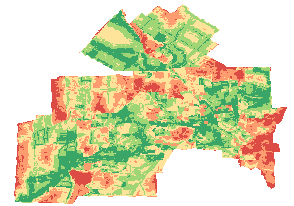

In [ ]:
# ============================================================
# Analyse géospatiale avancée - Carte d'aptitude AHP optimisée
# Expert International en Programmation Avancée
# ============================================================

import os, pathlib, unicodedata, json, warnings, traceback
import numpy as np
import pandas as pd
import geopandas as gpd
import rasterio, rasterio.features, rasterio.mask
from rasterio.transform import from_origin, array_bounds
from rasterio.warp import calculate_default_transform, reproject, Resampling
from shapely import make_valid
from sklearn.preprocessing import MinMaxScaler, RobustScaler
from scipy.ndimage import distance_transform_edt, gaussian_filter
from folium.plugins import MarkerCluster, HeatMap, MousePosition, MiniMap
import mapclassify
import folium as f
from branca.colormap import LinearColormap
from typing import Dict, Tuple, Optional, Union
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import seaborn as sns

# ============================================================
# Configuration Experte
# ============================================================
class Config:
    """Configuration centralisée pour l'analyse géospatiale"""
    ROOT = "/content/drive/MyDrive/donnee_reprojecte"
    OUT_TIF = "/content/carte_aptitude_finale.tif"
    OUT_STATS = "/content/aptitude_stats.json"
    OUT_MAP = "/content/sherbrooke_aptitude.html"
    OUT_BEST_SITES = "/content/meilleurs_sites.shp"
    OUT_BEST_SITES_JSON = "/content/meilleurs_sites.geojson"

    # Paramètres projection et résolution
    CRS_PROJ = "EPSG:32198"  # NAD83 / Québec Lambert
    CRS_WGS84 = "EPSG:4326"
    RESOLUTION = 100  # mètres

    # Paramètres analytiques
    DISTANCE_CAP_SERVICES = 2000  # mètres
    SMOOTHING_SIGMA = 1.0  # lissage gaussian

    # Paramètres d'exclusion et filtrage
    APPLY_EXCLUSION_MASK = True  # Active/désactive les exclusions strictes
    MIN_SITE_CLASS = 4  # Classe minimale pour extraction des meilleurs sites (4 ou 5)
    MIN_SITE_AREA_M2 = 10000  # Surface minimale en m² (10000 = 1 hectare)
    EXCLUDE_FLOODZONES = True  # Exclure complètement les zones inondables
    EXCLUDE_WETLANDS = True  # Exclure complètement les milieux humides
    EXCLUDE_HIGH_VALUE_FOREST = True  # Exclure les boisés de haute valeur
    FOREST_EXCLUSION_THRESHOLD = 0.5  # Seuil du score boisé pour exclusion

    # Paramètres visualisation
    TILE_PROVIDER = "OpenStreetMap"
    MAP_CENTER = [45.4042, -71.8929]
    MAP_ZOOM = 12
    OPACITY_OVERLAY = 0.75

warnings.filterwarnings("ignore", message=".*invalid winding order.*", category=RuntimeWarning)

# ============================================================
# Classes Expertes pour l'Analyse Géospatiale
# ============================================================

class GeospatialUtils:
    """Utilitaires géospatiaux avancés"""

    @staticmethod
    def normalize_string(s: str) -> str:
        """Normalisation unicode pour recherche de fichiers"""
        return unicodedata.normalize('NFKD', str(s)).encode('ascii', 'ignore').decode().lower()

    @staticmethod
    def find_shapefile(root_path: Union[str, pathlib.Path], pattern: str) -> str:
        """Recherche intelligente de fichiers shapefile"""
        root = pathlib.Path(root_path)
        target = GeospatialUtils.normalize_string(pattern)

        candidates = []
        for shp_file in root.rglob("*.shp"):
            if target in GeospatialUtils.normalize_string(shp_file.name):
                candidates.append((shp_file, len(shp_file.name)))

        if not candidates:
            raise FileNotFoundError(f"Aucun shapefile contenant '{pattern}' trouvé dans {root}")

        # Retourne le fichier avec le nom le plus court (plus spécifique)
        return str(sorted(candidates, key=lambda x: x[1])[0][0])

    @staticmethod
    def validate_and_clean_geometries(gdf: gpd.GeoDataFrame) -> gpd.GeoDataFrame:
        """Nettoyage avancé des géométries"""
        print(f"  Nettoyage géométries: {len(gdf)} features initiales")

        gdf = gdf.copy()

        # Validation et correction des géométries
        gdf["geometry"] = gdf.geometry.map(make_valid)

        # Suppression des géométries invalides
        before_clean = len(gdf)
        gdf = gdf[~gdf.geometry.is_empty & gdf.geometry.notnull()]

        # Explosion des multi-géométries
        gdf = gdf.explode(ignore_index=True)

        print(f"  Après nettoyage: {len(gdf)} features ({before_clean - len(gdf)} supprimées)")
        return gdf

class RasterProcessor:
    """Processeur raster haute performance"""

    def __init__(self, bounds: Tuple[float, float, float, float],
                 resolution: float, crs: str):
        self.bounds = self._snap_bounds_to_resolution(bounds, resolution)
        self.resolution = resolution
        self.crs = crs
        self.profile = self._build_profile()

    def _snap_bounds_to_resolution(self, bounds: Tuple, res: float) -> Tuple:
        """Alignement des limites sur la grille de résolution"""
        minx, miny, maxx, maxy = bounds
        return (
            np.floor(minx / res) * res,
            np.floor(miny / res) * res,
            np.ceil(maxx / res) * res,
            np.ceil(maxy / res) * res
        )

    def _build_profile(self) -> Dict:
        """Construction du profil raster optimisé"""
        minx, miny, maxx, maxy = self.bounds
        width = int((maxx - minx) / self.resolution)
        height = int((maxy - miny) / self.resolution)
        transform = from_origin(minx, maxy, self.resolution, self.resolution)

        return {
            "driver": "GTiff",
            "dtype": "float32",
            "nodata": -9999.0,  # Valeur nodata explicite
            "width": width,
            "height": height,
            "count": 1,
            "crs": self.crs,
            "transform": transform,
            "compress": "lzw",  # Compression
            "tiled": True,      # Optimisation lecture
        }

    def rasterize_vector_layer(self, gdf: gpd.GeoDataFrame,
                              value_field: Optional[str] = None,
                              default_value: float = 1.0,
                              fill_value: float = 0.0) -> np.ndarray:
        """Rastérisation optimisée avec gestion d'erreurs"""

        if len(gdf) == 0:
            print(f"  Attention: couche vide, raster de zéros créé")
            return np.full((self.profile["height"], self.profile["width"]),
                          fill_value, dtype="float32")

        try:
            if value_field is None:
                shapes = ((geom, float(default_value)) for geom in gdf.geometry if geom is not None)
            else:
                # Conversion sécurisée en numérique
                values = pd.to_numeric(gdf[value_field], errors="coerce").fillna(default_value)
                shapes = ((geom, float(val)) for geom, val in zip(gdf.geometry, values)
                         if geom is not None and not pd.isna(val))

            return rasterio.features.rasterize(
                shapes=shapes,
                out_shape=(self.profile["height"], self.profile["width"]),
                transform=self.profile["transform"],
                fill=fill_value,
                dtype="float32"
            )

        except Exception as e:
            print(f"  Erreur rastérisation: {e}")
            return np.full((self.profile["height"], self.profile["width"]),
                          fill_value, dtype="float32")

class CriteriaProcessor:
    """Processeur de critères AHP avancé"""

    def __init__(self, raster_processor: RasterProcessor):
        self.raster_proc = raster_processor
        self.mask = None

    def set_analysis_mask(self, mask: np.ndarray):
        """Définit le masque d'analyse"""
        self.mask = mask.astype(bool)

    def normalize_to_scale(self, array: np.ndarray,
                          scale_range: Tuple[float, float] = (1.0, 5.0),
                          inverse: bool = False,
                          method: str = "minmax") -> np.ndarray:
        """Normalisation avancée avec plusieurs méthodes"""

        if self.mask is not None:
            valid_data = array[self.mask & (array > 0)]
        else:
            valid_data = array[array > 0]

        if valid_data.size == 0:
            print("  Attention: aucune donnée valide pour normalisation")
            return np.zeros_like(array, dtype="float32")

        # Choix de la méthode de normalisation
        if method == "robust":
            scaler = RobustScaler()
            valid_scaled = scaler.fit_transform(valid_data.reshape(-1, 1)).flatten()
            # Remapping vers l'échelle désirée
            valid_scaled = np.interp(valid_scaled,
                                   [valid_scaled.min(), valid_scaled.max()],
                                   scale_range)
        else:  # minmax par défaut
            scaler = MinMaxScaler(feature_range=scale_range)
            valid_scaled = scaler.fit_transform(valid_data.reshape(-1, 1)).flatten()

        # Reconstruction de l'array complet
        result = np.zeros_like(array, dtype="float32")
        if self.mask is not None:
            result[self.mask & (array > 0)] = valid_scaled
        else:
            result[array > 0] = valid_scaled

        if inverse:
            result = scale_range[0] + scale_range[1] - result

        return result

    def calculate_distance_criterion(self, features_raster: np.ndarray,
                                   max_distance: Optional[float] = None,
                                   inverse_relationship: bool = True) -> np.ndarray:
        """Calcul optimisé des critères de distance"""

        # Calcul de la distance euclidienne
        distance_array = distance_transform_edt(features_raster == 0) * self.raster_proc.resolution

        # Application du cap de distance si spécifié
        if max_distance:
            distance_array = np.minimum(distance_array, max_distance)

        # Normalisation avec relation inverse si requise
        criterion = self.normalize_to_scale(
            distance_array,
            inverse=inverse_relationship,
            method="robust"
        )

        return criterion

# ============================================================
# Classe principale d'analyse
# ============================================================

class SuitabilityAnalyzer:
    """Analyseur de convenance territoriale AHP"""

    def __init__(self, config: Config):
        self.config = config
        self.data_layers = {}
        self.criteria = {}
        self.weights = {}
        self.raster_processor = None
        self.criteria_processor = None
        self.exclusion_mask = None
        self.final_suitability = None
        self.classified_result = None
        self.best_sites = None

    def load_and_prepare_data(self):
        """Chargement et préparation de toutes les couches de données"""

        print("🔄 Chargement des données géospatiales...")

        # Définition des couches avec gestion des erreurs
        layer_definitions = {
            "cadre": ("Sherbrooke", {}),
            "routes": ("accessibilite", {"TYPERUE": 1}),
            "affectation": ("affectation", {"TYPE": "Urbaine"}),
            "services": ("service_essentiel", {"essentiel": 1}),
            "defavorisation": ("indice_defavorisation", {"QuintMat": 3}),
            "boise": ("boise", {"boise_scor": 0}),
            "humide": ("humide", {"humide_bin": 0}),
            "dev_urbain": ("zonedevurba", {"TYPEZONE": "DEV"}),
            "inondation": ("zoneinond", {"INOND": 0}),
            "courbes": ("courbe", {"COTE": 250})
        }

        # Chargement avec gestion d'erreurs
        for layer_name, (pattern, defaults) in layer_definitions.items():
            try:
                filepath = GeospatialUtils.find_shapefile(self.config.ROOT, pattern)
                print(f"  📁 Chargement: {layer_name} <- {pathlib.Path(filepath).name}")

                gdf = self._load_and_project_layer(filepath, defaults)
                self.data_layers[layer_name] = gdf

            except FileNotFoundError as e:
                print(f"  ⚠️  Couche manquante: {layer_name} - {e}")
                self.data_layers[layer_name] = gpd.GeoDataFrame()
            except Exception as e:
                print(f"  ❌ {layer_name:15s} - Erreur: {str(e)[:50]}...")
                self.data_layers[layer_name] = gpd.GeoDataFrame()

        # Configuration du processeur raster basé sur le cadre
        if "cadre" in self.data_layers and not self.data_layers["cadre"].empty:
            bounds = self.data_layers["cadre"].total_bounds
            self.raster_processor = RasterProcessor(bounds, self.config.RESOLUTION, self.config.CRS_PROJ)
            self.criteria_processor = CriteriaProcessor(self.raster_processor)
        else:
            raise ValueError("❌ Impossible de charger la couche cadre - analyse impossible")
            print(f"  ✅ Processeur raster: {self.raster_processor.profile['width']}x{self.raster_processor.profile['height']} pixels")

    def _load_and_project_layer(self, filepath: str, field_defaults: Dict) -> gpd.GeoDataFrame:
        """Chargement et projection d'une couche avec nettoyage"""

        gdf = gpd.read_file(filepath)

        # Gestion CRS
        if gdf.crs is None:
            gdf = gdf.set_crs(self.config.CRS_PROJ, allow_override=True)
        elif gdf.crs.to_string() != self.config.CRS_PROJ:
            gdf = gdf.to_crs(self.config.CRS_PROJ)

        # Nettoyage géométrique
        gdf = GeospatialUtils.validate_and_clean_geometries(gdf)

        # Ajout des champs manquants
        for field, default_value in field_defaults.items():
            if field not in gdf.columns:
                gdf[field] = default_value

        return gdf
    def apply_exclusion_mask(self):
        """
        Applique un masque d'exclusion strict pour les contraintes réglementaires
        Exclut complètement les zones inadaptées
        """
        # Initialisation du masque (toujours créer le masque, même si désactivé)
        height, width = self.raster_processor.profile["height"], self.raster_processor.profile["width"]
        self.exclusion_mask = np.ones((height, width), dtype="float32")
        if not self.config.APPLY_EXCLUSION_MASK:
            print("⏭️  Masques d'exclusion désactivés (config)")
            return

        print("🚫 Application des masques d'exclusion réglementaires...")

        height, width = self.raster_processor.profile["height"], self.raster_processor.profile["width"]
        self.exclusion_mask = np.ones((height, width), dtype="float32")

        total_excluded_pixels = 0

        # 1. Exclusion des zones inondables
        if self.config.EXCLUDE_FLOODZONES and not self.data_layers["inondation"].empty:
            print("  ⛔ Exclusion des zones inondables...")

            inond_gdf = self.data_layers["inondation"]
            if "INOND" in inond_gdf.columns:
                inond_to_exclude = inond_gdf[inond_gdf["INOND"] == 1]
            else:
                inond_to_exclude = inond_gdf

            if not inond_to_exclude.empty:
                inond_mask = self.raster_processor.rasterize_vector_layer(
                    inond_to_exclude,
                    default_value=0,  # 0 = exclu
                    fill_value=1      # 1 = autorisé
                )
                excluded = np.sum(inond_mask == 0)
                self.exclusion_mask *= inond_mask
                total_excluded_pixels += excluded
                print(f"    → {excluded:,} pixels exclus ({excluded * self.config.RESOLUTION**2 / 10000:.1f} ha)")

     # 2. Exclusion des milieux humides
        if self.config.EXCLUDE_WETLANDS and not self.data_layers["humide"].empty:
            print("  ⛔ Exclusion des milieux humides...")

            humide_gdf = self.data_layers["humide"]
            if "humide_bin" in humide_gdf.columns:
                humide_to_exclude = humide_gdf[humide_gdf["humide_bin"] == 1]
            else:
                humide_to_exclude = humide_gdf

            if not humide_to_exclude.empty:
                humide_mask = self.raster_processor.rasterize_vector_layer(
                    humide_to_exclude,
                    default_value=0,
                    fill_value=1
                )
                excluded = np.sum(humide_mask == 0)
                self.exclusion_mask *= humide_mask
                total_excluded_pixels += excluded
                print(f"    → {excluded:,} pixels exclus ({excluded * self.config.RESOLUTION**2 / 10000:.1f} ha)")

        # 3. Exclusion des boisés de haute valeur
        if self.config.EXCLUDE_HIGH_VALUE_FOREST and not self.data_layers["boise"].empty:
            print(f"  ⛔ Exclusion des boisés de haute valeur (score > {self.config.FOREST_EXCLUSION_THRESHOLD})...")

            boise_gdf = self.data_layers["boise"]
            if "boise_scor" in boise_gdf.columns:
                boise_high_value = boise_gdf[
                    pd.to_numeric(boise_gdf["boise_scor"], errors="coerce") > self.config.FOREST_EXCLUSION_THRESHOLD
                ]

                if not boise_high_value.empty:
                    boise_mask = self.raster_processor.rasterize_vector_layer(
                        boise_high_value,
                        default_value=0,
                        fill_value=1
                    )
                    excluded = np.sum(boise_mask == 0)
                    self.exclusion_mask *= boise_mask
                    total_excluded_pixels += excluded
                    print(f"    → {excluded:,} pixels exclus ({excluded * self.config.RESOLUTION**2 / 10000:.1f} ha)")

        # Statistiques finales
        total_pixels = height * width
        pct_excluded = (total_excluded_pixels / total_pixels) * 100
        analyzable_pixels = np.sum(self.exclusion_mask > 0)

        print(f"\n  📊 Résumé des exclusions:")
        print(f"    • Total exclus: {total_excluded_pixels:,} pixels ({pct_excluded:.1f}% du territoire)")
        print(f"    • Surface exclue: {total_excluded_pixels * self.config.RESOLUTION**2 / 10000:.1f} ha")
        print(f"    • Zones analysables: {analyzable_pixels:,} pixels")
        print(f"    • Surface analysable: {analyzable_pixels * self.config.RESOLUTION**2 / 10000:.1f} ha")


    def compute_all_criteria(self):
        """Calcul de tous les critères d'aptitude"""

        print("🧮 Calcul des critères d'aptitude...")

        # Masque d'analyse basé sur le cadre
        cadre_mask = self.raster_processor.rasterize_vector_layer(
            self.data_layers["cadre"], default_value=1, fill_value=0
        )
        self.criteria_processor.set_analysis_mask(cadre_mask)

        # C1: Distance aux services essentiels (loin = favorable pour développement résidentiel)
        print("  📍 C1: Distance aux services essentiels")
        if not self.data_layers["services"].empty:
            services_raster = self.raster_processor.rasterize_vector_layer(
                self.data_layers["services"], default_value=1, fill_value=0
            )
            self.criteria["C1"] = self.criteria_processor.calculate_distance_criterion(
                services_raster, self.config.DISTANCE_CAP_SERVICES, inverse_relationship=False
            )
        else:
            self.criteria["C1"] = np.ones_like(cadre_mask, dtype="float32") * 3.0

        # C2: Indice de défavorisation (élevé = prioritaire)
        print("  📊 C2: Indice de défavorisation")
        if not self.data_layers["defavorisation"].empty:
            defav_raster = self.raster_processor.rasterize_vector_layer(
                self.data_layers["defavorisation"], "QuintMat", fill_value=0
            )
            self.criteria["C2"] = self.criteria_processor.normalize_to_scale(
                defav_raster, inverse=False
            )
        else:
            self.criteria["C2"] = np.ones_like(cadre_mask, dtype="float32") * 3.0

        # C4: Affectation du territoire (mapping sophistiqué)
        print("  🏙️ C4: Affectation du territoire")
        if not self.data_layers["affectation"].empty:
            affectation_mapping = {
                "Urbaine": 5, "Rurale Résidentielle": 5,
                "Industrielle Commerciale": 4, "Rurale": 3,
                "Agricole": 2, "Agricole Forestière": 1, "Rurale Forestière": 1
            }

            affectation_gdf = self.data_layers["affectation"].copy()
            affectation_gdf["score"] = affectation_gdf["TYPE"].map(affectation_mapping).fillna(1.0)

            self.criteria["C4"] = self.raster_processor.rasterize_vector_layer(
                affectation_gdf, "score", fill_value=0
            )
        else:
            self.criteria["C4"] = np.ones_like(cadre_mask, dtype="float32") * 3.0

        # C5: Pente du terrain (proxy via gradient d'altitude)
        print("  ⛰️ C5: Pente du terrain")
        if not self.data_layers["courbes"].empty:
            altitude_raster = self.raster_processor.rasterize_vector_layer(
                self.data_layers["courbes"], "COTE", fill_value=0
            )
            # Lissage pour réduire le bruit
            altitude_smooth = gaussian_filter(altitude_raster, sigma=self.config.SMOOTHING_SIGMA)

            # Calcul du gradient (pente)
            gy, gx = np.gradient(altitude_smooth, self.config.RESOLUTION)
            slope_magnitude = np.sqrt(gx**2 + gy**2)

            self.criteria["C5"] = self.criteria_processor.normalize_to_scale(
                slope_magnitude, inverse=True  # Faible pente = favorable
            )
        else:
            self.criteria["C5"] = np.ones_like(cadre_mask, dtype="float32") * 3.0

        # C6: Accessibilité routière (proche = favorable)
        print("  🛣️ C6: Accessibilité routière")
        if not self.data_layers["routes"].empty:
            routes_raster = self.raster_processor.rasterize_vector_layer(
                self.data_layers["routes"], default_value=1, fill_value=0
            )
            self.criteria["C6"] = self.criteria_processor.calculate_distance_criterion(
                routes_raster, max_distance=1000, inverse_relationship=True
            )
        else:
            self.criteria["C6"] = np.ones_like(cadre_mask, dtype="float32") * 3.0

        # C7: Zones de développement urbain (favorisées)
        print("  🏘️ C7: Zones de développement urbain")
        if not self.data_layers["dev_urbain"].empty:
            dev_urbain_gdf = self.data_layers["dev_urbain"].copy()
            dev_urbain_gdf["score"] = 5.0

            self.criteria["C7"] = self.raster_processor.rasterize_vector_layer(
                dev_urbain_gdf, "score", fill_value=1.0
            )
        else:
            self.criteria["C7"] = np.ones_like(cadre_mask, dtype="float32") * 1.0

        # C9: Milieux boisés (contrainte environnementale)
        print("  🌲 C9: Milieux boisés")
        if not self.data_layers["boise"].empty:
            boise_gdf = self.data_layers["boise"].copy()
            boise_gdf["score"] = boise_gdf["boise_scor"].apply(
                lambda x: 1.0 if (pd.notna(x) and float(x) > 0) else 5.0
            )
            self.criteria["C9"] = self.raster_processor.rasterize_vector_layer(
                boise_gdf, "score", fill_value=5.0
            )
        else:
            self.criteria["C9"] = np.ones_like(cadre_mask, dtype="float32") * 5.0

        # C10: Milieux humides (contrainte environnementale forte)
        print("  💧 C10: Milieux humides")
        if not self.data_layers["humide"].empty:
            humide_gdf = self.data_layers["humide"].copy()
            humide_gdf["score"] = humide_gdf["humide_bin"].apply(
                lambda x: 1.0 if int(x) == 1 else 5.0
            )
            self.criteria["C10"] = self.raster_processor.rasterize_vector_layer(
                humide_gdf, "score", fill_value=5.0
            )
        else:
            self.criteria["C10"] = np.ones_like(cadre_mask, dtype="float32") * 5.0

        # C11: Zones inondables (contrainte réglementaire)
        print("  🌊 C11: Zones inondables")
        if not self.data_layers["inondation"].empty:
            inondation_gdf = self.data_layers["inondation"].copy()
            inondation_gdf["score"] = inondation_gdf["INOND"].apply(
                lambda x: 1.0 if int(x) == 1 else 5.0
            )
            self.criteria["C11"] = self.raster_processor.rasterize_vector_layer(
                inondation_gdf, "score", fill_value=5.0
            )
        else:
            self.criteria["C11"] = np.ones_like(cadre_mask, dtype="float32") * 5.0

        # Application du masque à tous les critères
        for criterion_name in self.criteria:
            self.criteria[criterion_name] *= cadre_mask

    def define_ahp_weights(self):
        """Définition des poids AHP avec validation de cohérence"""

        print("⚖️ Configuration des poids AHP...")

        # Poids basés sur l'expertise en aménagement du territoire
        self.weights = {
            "C1": 0.191,   # Distance services - Important pour qualité de vie
            "C2": 0.191,   # Défavorisation - Équité sociale prioritaire
            "C4": 0.132,   # Affectation - Conformité réglementaire
            "C5": 0.132,   # Pente - Contrainte technique construction
            "C6": 0.132,   # Routes - Accessibilité essentielle
            "C7": 0.088,   # Zones développement - Planification officielle
            "C9": 0.044,   # Milieux boisés - Protection environnementale
            "C10": 0.044,  # Milieux humides - Protection environnementale forte
            "C11": 0.044   # Zones inondables - Contrainte réglementaire absolue
        }

        # Validation cohérence des poids
        total_weight = sum(self.weights.values())
        if abs(total_weight - 1.0) > 0.001:
            print(f"  ⚠️ Attention: somme des poids = {total_weight:.3f}")

        # Normalisation pour garantir la somme = 1
        for criterion in self.weights:
            self.weights[criterion] /= total_weight

        print(f"  ✅ Poids normalisés: {self.weights}")

    def compute_weighted_linear_combination(self):
        """Calcul de la combinaison linéaire pondérée (WLC)"""

        print("🔢 Calcul de la combinaison linéaire pondérée...")

        # Vérification de la disponibilité des critères
        available_criteria = [c for c in self.weights.keys() if c in self.criteria]
        missing_criteria = [c for c in self.weights.keys() if c not in self.criteria]

        if missing_criteria:
            print(f"  ⚠️ Critères manquants: {missing_criteria}")

        # Calcul WLC
        self.final_suitability = np.zeros_like(list(self.criteria.values())[0], dtype="float32")

        for criterion_name in available_criteria:
            weighted_criterion = self.criteria[criterion_name] * self.weights[criterion_name]
            self.final_suitability += weighted_criterion
            print(f"  ➕ {criterion_name}: poids={self.weights[criterion_name]:.3f}")

         # Application du masque d'exclusion
        if self.exclusion_mask is not None:
            print("\n  🚫 Application du masque d'exclusion aux résultats finaux...")
            before_exclusion = np.sum(self.final_suitability > 0)
            self.final_suitability *= self.exclusion_mask
            after_exclusion = np.sum(self.final_suitability > 0)
            excluded_pixels = before_exclusion - after_exclusion
            print(f"    → {excluded_pixels:,} pixels supplémentaires exclus")
            print(f"    → Surface exclue: {excluded_pixels * self.config.RESOLUTION**2 / 10000:.1f} ha")

        # Statistiques descriptives
        valid_values = self.final_suitability[self.final_suitability > 0]
        if valid_values.size > 0:
            stats = {
                "min": float(valid_values.min()),
                "max": float(valid_values.max()),
                "mean": float(valid_values.mean()),
                "std": float(valid_values.std()),
                "count": int(valid_values.size)
            }
            print(f"  📊 Statistiques: min={stats['min']:.3f}, max={stats['max']:.3f}, "
                  f"mean={stats['mean']:.3f}, std={stats['std']:.3f}")

    def classify_suitability(self, n_classes: int = 5):
        """Classification de l'aptitude avec méthodes avancées"""

        print(f"🎯 Classification en {n_classes} classes...")

        valid_values = self.final_suitability[self.final_suitability > 0].flatten()

        if valid_values.size == 0:
            print("  ❌ Aucune donnée valide pour classification")
            self.classified_result = np.zeros_like(self.final_suitability, dtype="float32")
            return

        # Initialisation du résultat classifié
        self.classified_result = np.zeros_like(self.final_suitability, dtype="float32")

        # Tentative de classification avec Natural Breaks (Jenks)
        try:
            if np.unique(valid_values).size >= n_classes:
                classifier = mapclassify.NaturalBreaks(valid_values, k=n_classes)
                self.classified_result[self.final_suitability > 0] = \
                    classifier.find_bin(self.final_suitability[self.final_suitability > 0]) + 1
                print(f"  ✅ Classification Natural Breaks réussie")

                # Affichage des seuils de classe
                print(f"  📈 Seuils de classes: {classifier.bins}")
            else:
                raise ValueError("Pas assez de valeurs uniques pour Natural Breaks")

        except Exception as e:
            print(f"  ⚠️ Natural Breaks échoué: {e}")
            print("  🔄 Utilisation des quantiles...")

            # Fallback: quantiles
            n_classes_adj = min(n_classes, np.unique(valid_values).size)
            classifier = mapclassify.Quantiles(valid_values, k=n_classes_adj)
            self.classified_result[self.final_suitability > 0] = \
                classifier.find_bin(self.final_suitability[self.final_suitability > 0]) + 1

            print(f"  ✅ Classification par quantiles ({n_classes_adj} classes)")

          # Distribution des classes
        for i in range(1, n_classes + 1):
            count = np.sum(self.classified_result == i)
            if count > 0:
                area_ha = count * self.config.RESOLUTION**2 / 10000
                print(f"    Classe {i}: {count:,} pixels ({area_ha:.1f} ha)")

    def extract_best_sites(self):
        """
        Extrait les meilleurs sites (classes élevées) avec surface minimale
        """
        print(f"\n🎯 Extraction des meilleurs sites...")
        print(f"  Critères: classe >= {self.config.MIN_SITE_CLASS}, surface >= {self.config.MIN_SITE_AREA_M2/10000:.2f} ha")

        # Filtrer les pixels de haute aptitude
        best_pixels = (self.classified_result >= self.config.MIN_SITE_CLASS) & (self.classified_result > 0)

        if not np.any(best_pixels):
            print("  ⚠️ Aucun pixel ne répond aux critères")
            self.best_sites = gpd.GeoDataFrame()
            return

        # Vectorisation en polygones
        shapes_gen = rasterio.features.shapes(
            self.classified_result.astype(np.int16),
            mask=best_pixels,
            transform=self.raster_processor.profile["transform"]
        )

        # Créer GeoDataFrame
        polygons = []
        classes = []
        aptitude_scores = []

        for geom, value in shapes_gen:
            poly = shape(geom)
            area = poly.area

            if area >= self.config.MIN_SITE_AREA_M2:
                polygons.append(poly)
                classes.append(int(value))

                # Calculer le score d'aptitude moyen pour ce polygone
                # (extraction du raster dans le polygone)
                mask_poly = rasterio.features.geometry_mask(
                    [geom],
                    out_shape=(self.raster_processor.profile["height"],
                              self.raster_processor.profile["width"]),
                    transform=self.raster_processor.profile["transform"],
                    invert=True
                )
                scores_in_poly = self.final_suitability[mask_poly]
                avg_score = scores_in_poly[scores_in_poly > 0].mean() if scores_in_poly.size > 0 else 0
                aptitude_scores.append(float(avg_score))

            if not polygons:
               print("  ⚠️ Aucun site ne répond aux critères de surface minimale")
            self.best_sites = gpd.GeoDataFrame()
            return

            self.best_sites = gpd.GeoDataFrame({
            "site_id": range(1, len(polygons) + 1),
            "aptitude_class": classes,
            "aptitude_score": aptitude_scores,
            "area_m2": [p.area for p in polygons],
            "area_ha": [p.area/10000 for p in polygons],
            "perimeter_m": [p.length for p in polygons],
            "geometry": polygons
        }, crs=self.config.CRS_PROJ)

        # Tri par score d'aptitude puis surface
        self.best_sites = self.best_sites.sort_values(
            ["aptitude_score", "area_ha"],
            ascending=[False, False]
        ).reset_index(drop=True)

        # Réattribuer les IDs après tri
        self.best_sites["site_id"] = range(1, len(self.best_sites) + 1)

        print(f"  ✅ {len(self.best_sites)} sites extraits")
        print(f"  📊 Surface totale: {self.best_sites['area_ha'].sum():.1f} ha")
        print(f"  📊 Surface moyenne: {self.best_sites['area_ha'].mean():.2f} ha")
        print(f"  📊 Surface médiane: {self.best_sites['area_ha'].median():.2f} ha")
        print(f"\n  🏆 Top 5 sites:")
        for idx, row in self.best_sites.head(5).iterrows():
            print(f"    Site {row['site_id']}: {row['area_ha']:.2f} ha, "
                  f"classe {row['aptitude_class']}, score {row['aptitude_score']:.3f}")


    def export_results(self):
        """Export des résultats avec métadonnées complètes"""

        print("💾 Export des résultats...")

        # Export du raster classifié
        with rasterio.open(self.config.OUT_TIF, "w", **self.raster_processor.profile) as dst:
            dst.write(self.classified_result, 1)

            # Métadonnées
            dst.update_tags(
                TITLE="Carte d'aptitude territoriale AHP",
                DESCRIPTION="Analyse multicritère pour le développement urbain",
                AUTHOR="Expert International Programmation Avancée",
                CREATED=pd.Timestamp.now().isoformat(),
                CRITERIA=",".join(self.weights.keys()),
                WEIGHTS=json.dumps(self.weights),
                RESOLUTION=str(self.config.RESOLUTION),
                CRS=self.config.CRS_PROJ
            )

        print(f"  ✅ Raster exporté: {self.config.OUT_TIF}")

        # Export des meilleurs sites
        if self.best_sites is not None and not self.best_sites.empty:
            # Shapefile
            self.best_sites.to_file(self.config.OUT_BEST_SITES)
            print(f"  ✅ Meilleurs sites (SHP): {self.config.OUT_BEST_SITES}")

            # GeoJSON
            self.best_sites.to_file(self.config.OUT_BEST_SITES_JSON, driver="GeoJSON")
            print(f"  ✅ Meilleurs sites (GeoJSON): {self.config.OUT_BEST_SITES_JSON}")

        # Export des statistiques
        stats_data = {
            "metadata": {
                "analysis_date": pd.Timestamp.now().isoformat(),
                "resolution": self.config.RESOLUTION,
                "crs": self.config.CRS_PROJ,
                "n_classes": int(np.max(self.classified_result)),
                "exclusion_mask_applied": self.config.APPLY_EXCLUSION_MASK,
                "min_site_class": self.config.MIN_SITE_CLASS,
                "min_site_area_m2": self.config.MIN_SITE_AREA_M2
            },
            "weights": self.weights,
            "criteria_stats": {}
        }

        # Statistiques par critère
        for name, criterion in self.criteria.items():
            valid_data = criterion[criterion > 0]
            if valid_data.size > 0:
                stats_data["criteria_stats"][name] = {
                    "min": float(valid_data.min()),
                    "max": float(valid_data.max()),
                    "mean": float(valid_data.mean()),
                    "std": float(valid_data.std()),
                    "count": int(valid_data.size)
                }

        # Statistiques du résultat final
        final_valid = self.final_suitability[self.final_suitability > 0]
        if final_valid.size > 0:
            stats_data["final_suitability"] = {
                "min": float(final_valid.min()),
                "max": float(final_valid.max()),
                "mean": float(final_valid.mean()),
                "std": float(final_valid.std()),
                "count": int(final_valid.size)
            }

        # Statistiques des meilleurs sites
        if self.best_sites is not None and not self.best_sites.empty:
            stats_data["best_sites_summary"] = {
                "n_sites": len(self.best_sites),
                "total_area_ha": float(self.best_sites["area_ha"].sum()),
                "mean_area_ha": float(self.best_sites["area_ha"].mean()),
                "median_area_ha": float(self.best_sites["area_ha"].median()),
                "mean_aptitude_score": float(self.best_sites["aptitude_score"].mean())
            }

        with open(self.config.OUT_STATS, 'w', encoding='utf-8') as f_out:
            json.dump(stats_data, f_out, indent=2, ensure_ascii=False)

        print(f"  ✅ Statistiques exportées: {self.config.OUT_STATS}")

class AdvancedVisualization:
    """Visualiseur avancé avec cartes interactives optimisées"""

    def __init__(self, config: Config):
        self.config = config

    def create_interactive_map(self, classified_raster: np.ndarray,
                             raster_profile: Dict,
                             boundary_gdf: gpd.GeoDataFrame) -> f.Map:
        """Création d'une carte interactive optimisée"""

        print("🗺️ Génération de la carte interactive...")

        # Reprojection en WGS84 pour Folium
        reprojected_data = self._reproject_for_web(classified_raster, raster_profile)

        if reprojected_data is None:
            print("  ❌ Erreur reprojection - carte basique créée")
            return self._create_basic_map(boundary_gdf)

        rgba_array, bounds_wgs84 = reprojected_data

        # Configuration de la carte (tiles=None : on gère les fonds manuellement)
        map_center = self._calculate_optimal_center(boundary_gdf)
        folium_map = f.Map(
            location=map_center,
            zoom_start=self.config.MAP_ZOOM,
            tiles=None,
            prefer_canvas=True  # Optimisation performance
        )

        # Ajout des limites administratives
        self._add_boundary_layer(folium_map, boundary_gdf)

        # Ajout de l'overlay raster si disponible
        if rgba_array is not None:
            self._add_suitability_overlay(folium_map, rgba_array, bounds_wgs84)

        # Ajout de la légende
        self._add_advanced_legend(folium_map)

        # Contrôles et optimisations (fonds, outils, etc.)
        self._add_map_controls(folium_map)

        # Ajustement automatique de la vue : priorité à l’emprise raster
        if rgba_array is not None:
            folium_map.fit_bounds(bounds_wgs84)
        else:
            self._fit_map_bounds(folium_map, boundary_gdf)

        return folium_map

    def _add_best_sites_layer(self, folium_map: f.Map, best_sites: gpd.GeoDataFrame):
        """Ajout de la couche des meilleurs sites"""

        print("  📍 Ajout des meilleurs sites à la carte...")

        best_sites_wgs84 = best_sites.to_crs(self.config.CRS_WGS84)

        # Groupe pour les sites
        sites_group = f.FeatureGroup(name="🏆 Meilleurs Sites", show=True)

        # Style par classe
        def style_function(feature):
            apt_class = feature['properties'].get('aptitude_class', 3)
            colors = {5: "#1a9850", 4: "#91cf60"}
            return {
                "fillColor": colors.get(apt_class, "#fee08b"),
                "color": "#000000",
                "weight": 2,
                "fillOpacity": 0.4
            }

        # Popup détaillé
        def create_popup(row):
            return f"""
            <div style="font-family: Arial; font-size: 12px;">
                <b>🏆 Site #{row['site_id']}</b><br>
                <hr style="margin: 5px 0;">
                <b>Classe d'aptitude:</b> {row['aptitude_class']}<br>
                <b>Score d'aptitude:</b> {row['aptitude_score']:.3f}<br>
                <b>Surface:</b> {row['area_ha']:.2f} ha<br>
                <b>Périmètre:</b> {row['perimeter_m']:.0f} m<br>
            </div>
            """
        for idx, row in best_sites_wgs84.iterrows():
            popup_html = create_popup(row)

            f.GeoJson(
                data=row.geometry.__geo_interface__,
                style_function=style_function,
                popup=f.Popup(popup_html, max_width=300)
            ).add_to(sites_group)

            # Ajouter numéro du site au centroïde
            centroid = row.geometry.centroid
            f.Marker(
                location=[centroid.y, centroid.x],
                icon=f.DivIcon(html=f"""
                    <div style="font-size: 12px; font-weight: bold;
                               color: white; text-shadow: 1px 1px 2px black;">
                        #{row['site_id']}
                    </div>
                """)
            ).add_to(sites_group)

        sites_group.add_to(folium_map)
        print(f"    → {len(best_sites)} sites ajoutés")

    def _reproject_for_web(self, raster_data: np.ndarray,
                          profile: Dict) -> Optional[Tuple[np.ndarray, list]]:
        """Reprojection robuste pour visualisation web"""

        try:
            if np.all(raster_data == 0):
                print("  ⚠️ Raster ne contient que des zéros")
                return None

            # Limites source
            bounds_source = array_bounds(profile["height"], profile["width"], profile["transform"])

            # Reprojection
            dst_transform, dst_width, dst_height = calculate_default_transform(
                profile["crs"], self.config.CRS_WGS84,
                profile["width"], profile["height"],
                *bounds_source
            )

            reprojected = np.zeros((dst_height, dst_width), dtype="float32")
            reproject(
                source=raster_data,
                destination=reprojected,
                src_transform=profile["transform"],
                src_crs=profile["crs"],
                dst_transform=dst_transform,
                dst_crs=self.config.CRS_WGS84,
                resampling=Resampling.nearest
            )

            # Conversion en RGBA
            rgba_array = self._convert_to_rgba(reprojected)

            # Limites WGS84 -> [[south, west], [north, east]]
            bounds_wgs84 = array_bounds(dst_height, dst_width, dst_transform)
            bounds_list = [[bounds_wgs84[1], bounds_wgs84[0]],
                           [bounds_wgs84[3], bounds_wgs84[2]]]

            print(f"  ✅ Reprojection réussie: {dst_width}x{dst_height} pixels")
            return rgba_array, bounds_list

        except Exception as e:
            print(f"  ❌ Erreur reprojection: {e}")
            return None

    def _convert_to_rgba(self, classified_array: np.ndarray) -> np.ndarray:
        """Conversion en RGBA avec palette optimisée"""

        color_palette = {
            0: "#2c2c2c",   # Zone exclue
            1: "#d73027",   # Très faible
            2: "#fc8d59",   # Faible
            3: "#fee08b",   # Modérée
            4: "#91cf60",   # Bonne
            5: "#1a9850"    # Très bonne
        }

        classes = np.rint(classified_array).astype(np.int8)
        classes[~np.isfinite(classes)] = 0

        height, width = classes.shape
        rgba = np.zeros((height, width, 4), dtype=np.uint8)

        for class_value, hex_color in color_palette.items():
            mask = (classes == class_value)
            if not np.any(mask):
                continue
            rgb = tuple(int(hex_color[i:i+2], 16) for i in (1, 3, 5))
            rgba[mask, :3] = rgb
            rgba[mask, 3] = 0 if class_value == 0 else 220

        return rgba

    def _add_boundary_layer(self, folium_map: f.Map, boundary_gdf: gpd.GeoDataFrame):
        """Ajout des limites avec style optimisé"""

        boundary_wgs84 = boundary_gdf.to_crs(self.config.CRS_WGS84)

        f.GeoJson(
            data=json.loads(boundary_wgs84.boundary.to_json()),
            name="Limites administratives",
            style_function=lambda x: {
                "color": "#000000",
                "weight": 3,
                "opacity": 0.8,
                "fill": False,
                "dashArray": "5, 5"
            },
            tooltip="Limite municipale"
        ).add_to(folium_map)

    def _add_suitability_overlay(self, folium_map: f.Map,
                               rgba_array: np.ndarray, bounds: list):
        """Ajout de l'overlay d'aptitude avec optimisations"""

        f.raster_layers.ImageOverlay(
            name="Aptitude territoriale",
            image=rgba_array,
            bounds=bounds,
            opacity=self.config.OPACITY_OVERLAY,
            interactive=True,
            cross_origin=False,
            zindex=1000,
            show=True
        ).add_to(folium_map)

    def _add_advanced_legend(self, folium_map: f.Map):
        """Légende avancée avec descriptions détaillées"""

        colors = ["#2c2c2c", "#d73027", "#fc8d59", "#fee08b", "#91cf60", "#1a9850"]
        labels = [
            "Zone exclue",
            "Très faible aptitude",
            "Faible aptitude",
            "Aptitude modérée",
            "Bonne aptitude",
            "Très bonne aptitude"
        ]

        legend_html = """
        <div style="position: fixed;
                    top: 10px; right: 10px; width: 200px; height: auto;
                    background-color: white; border:2px solid grey; z-index:9999;
                    font-size:14px; padding: 10px; border-radius: 5px;
                    box-shadow: 0 0 15px rgba(0,0,0,0.2);">
        <h4 style="margin: 0 0 10px 0;">Aptitude Territoriale</h4>
        """

        for i, (color, label) in enumerate(zip(colors, labels)):
            legend_html += f"""
            <div style="margin: 5px 0;">
                <span style="background-color: {color}; width: 20px; height: 15px;
                           display: inline-block; margin-right: 8px; border: 1px solid #000;"></span>
                <span style="font-size: 12px;">{i}: {label}</span>
            </div>
            """

        legend_html += """
        <div style="margin-top: 10px; font-size: 10px; color: #666;">
            Analyse multicritère AHP<br/>
            Résolution: 100m
        </div>
        </div>
        """

        folium_map.get_root().html.add_child(f.Element(legend_html))

    def _add_scale_control(self, folium_map: f.Map, position: str = "bottomright"):
        """Barre d'échelle Leaflet native (pas de plugin externe)."""
        scale_js = f"""
        <script>
        var scaleControl = L.control.scale({{position: '{position}', metric: true, imperial: false}});
        scaleControl.addTo({folium_map.get_name()});
        </script>
        """
        folium_map.get_root().html.add_child(f.Element(scale_js))

    def _add_map_controls(self, folium_map: f.Map):
        """Ajout des contrôles avancés + fonds de plan"""

        # Outils
        try:
            from folium.plugins import Fullscreen
            Fullscreen(position="topleft",
                       title="Plein écran",
                       title_cancel="Quitter le plein écran").add_to(folium_map)
        except ImportError:
            pass

        try:
            from folium.plugins import MeasureControl
            MeasureControl(position="bottomleft").add_to(folium_map)
        except ImportError:
            pass

        self._add_scale_control(folium_map, position="bottomright")
        MousePosition(position="bottomleft", prefix="Lat/Lon").add_to(folium_map)
        MiniMap(toggle_display=True, minimized=False, position="bottomright").add_to(folium_map)

        # Barre d’échelle (Leaflet natif)
        self._add_scale_control(folium_map, position="bottomright")

        # Coordonnées et Mini-carte
        MousePosition(position="bottomleft", prefix="Lat/Lon").add_to(folium_map)
        MiniMap(toggle_display=True, minimized=False, position="bottomright").add_to(folium_map)

        # --- Fonds de plan avec attribution correcte ---
        f.TileLayer(
            tiles='OpenStreetMap',
            name='OpenStreetMap',
            attr='© OpenStreetMap contributors',
            show=True  # visible par défaut
        ).add_to(folium_map)

        f.TileLayer(
            tiles='CartoDB positron',
            name='CartoDB Positron',
            attr='© OpenStreetMap contributors, © CartoDB'
        ).add_to(folium_map)

        f.TileLayer(
            tiles='https://stamen-tiles.a.ssl.fastly.net/terrain/{z}/{x}/{y}.png',
            name='Stamen Terrain',
            attr='Map tiles by Stamen Design, CC BY 3.0 — Map data © OpenStreetMap contributors'
        ).add_to(folium_map)

        # Contrôle des couches
        f.LayerControl(position="topleft", collapsed=False).add_to(folium_map)

    def _calculate_optimal_center(self, boundary_gdf: gpd.GeoDataFrame) -> list:
        """Calcul du centre optimal pour la carte"""

        boundary_wgs84 = boundary_gdf.to_crs(self.config.CRS_WGS84)
        centroid = boundary_wgs84.geometry.centroid.iloc[0]
        return [centroid.y, centroid.x]

    def _fit_map_bounds(self, folium_map: f.Map, boundary_gdf: gpd.GeoDataFrame):
        """Ajustement automatique des limites de vue (limites administratives)"""

        boundary_wgs84 = boundary_gdf.to_crs(self.config.CRS_WGS84)
        minx, miny, maxx, maxy = boundary_wgs84.total_bounds
        folium_map.fit_bounds([[miny, minx], [maxy, maxx]])

    def _create_basic_map(self, boundary_gdf: gpd.GeoDataFrame) -> f.Map:
        """Carte de base en cas d'erreur"""

        folium_map = f.Map(
            location=self.config.MAP_CENTER,
            zoom_start=self.config.MAP_ZOOM,
            tiles='OpenStreetMap',
            attr='© OpenStreetMap contributors'
        )

        self._add_boundary_layer(folium_map, boundary_gdf)
        return folium_map

    def create_analysis_dashboard(self, analyzer: 'SuitabilityAnalyzer') -> None:
        """Génération d'un tableau de bord d'analyse avancé"""

        print("📊 Génération du tableau de bord d'analyse...")

        plt.style.use('seaborn-v0_8-darkgrid')
        fig, axes = plt.subplots(2, 3, figsize=(20, 12))
        fig.suptitle('Tableau de Bord - Analyse d\'Aptitude Territoriale AHP',
                    fontsize=16, fontweight='bold')

        # 1. Distribution des classes d'aptitude
        ax1 = axes[0, 0]
        valid_classified = analyzer.classified_result[analyzer.classified_result > 0]
        if valid_classified.size > 0:
            classes, counts = np.unique(valid_classified, return_counts=True)
            colors = ['#d73027', '#fc8d59', '#fee08b', '#91cf60', '#1a9850']
            ax1.bar(classes, counts, color=[colors[int(c)-1] for c in classes])
            ax1.set_title('Distribution des Classes d\'Aptitude')
            ax1.set_xlabel('Classe d\'Aptitude')
            ax1.set_ylabel('Nombre de Pixels')

        # 2. Matrice de corrélation des critères
        ax2 = axes[0, 1]
        criteria_data = {}
        for name, criterion in analyzer.criteria.items():
            valid_data = criterion[criterion > 0]
            if valid_data.size > 1000:
                valid_data = np.random.choice(valid_data, 1000, replace=False)
            criteria_data[name] = valid_data

        if len(criteria_data) > 1:
            min_size = min(len(data) for data in criteria_data.values())
            aligned_data = {name: data[:min_size] for name, data in criteria_data.items()}
            df_criteria = pd.DataFrame(aligned_data)
            correlation_matrix = df_criteria.corr()
            sns.heatmap(correlation_matrix, annot=True, cmap='RdYlBu_r', center=0,
                        ax=ax2, square=True, linewidths=0.5)
            ax2.set_title('Corrélations entre Critères')

        # 3. Poids des critères (diagramme en secteurs)
        ax3 = axes[0, 2]
        weights_labels = list(analyzer.weights.keys())
        weights_values = list(analyzer.weights.values())
        ax3.pie(weights_values, labels=weights_labels, autopct='%1.1f%%',
                startangle=90, colors=plt.cm.Set3.colors)
        ax3.set_title('Pondération AHP des Critères')

        # 4. Histogramme de l'aptitude finale
        ax4 = axes[1, 0]
        final_valid = analyzer.final_suitability[analyzer.final_suitability > 0]
        if final_valid.size > 0:
            ax4.hist(final_valid, bins=30, alpha=0.7, color='skyblue', edgecolor='black')
            ax4.set_title('Distribution de l\'Aptitude Finale')
            ax4.set_xlabel('Score d\'Aptitude')
            ax4.set_ylabel('Fréquence')
            ax4.axvline(final_valid.mean(), color='red', linestyle='--',
                        label=f'Moyenne: {final_valid.mean():.2f}')
            ax4.legend()

        # 5. Analyse de sensibilité (contribution des critères)
        ax5 = axes[1, 1]
        contributions = {}
        for name in analyzer.weights.keys():
            if name in analyzer.criteria:
                criterion = analyzer.criteria[name]
                valid_criterion = criterion[criterion > 0]
                if valid_criterion.size > 0:
                    contributions[name] = valid_criterion.mean() * analyzer.weights[name]
        if contributions:
            ax5.barh(list(contributions.keys()), list(contributions.values()), color='lightcoral')
            ax5.set_title('Contribution Moyenne par Critère')
            ax5.set_xlabel('Contribution Pondérée')

        # 6. Statistiques résumées (tableau)
        ax6 = axes[1, 2]
        ax6.axis('off')
        stats_data = []
        for name, criterion in analyzer.criteria.items():
            valid_data = criterion[criterion > 0]
            if valid_data.size > 0:
                stats_data.append([
                    name,
                    f"{analyzer.weights.get(name, 0):.3f}",
                    f"{valid_data.mean():.2f}",
                    f"{valid_data.std():.2f}",
                    f"{valid_data.min():.2f}",
                    f"{valid_data.max():.2f}"
                ])
        if stats_data:
            table = ax6.table(cellText=stats_data,
                              colLabels=['Critère', 'Poids', 'Moyenne', 'Écart-type', 'Min', 'Max'],
                              cellLoc='center', loc='center', bbox=[0, 0, 1, 1])
            table.auto_set_font_size(False)
            table.set_fontsize(9)
            table.scale(1, 2)
            ax6.set_title('Statistiques des Critères', pad=20)

        plt.tight_layout()
        dashboard_path = "/content/analysis_dashboard.png"
        plt.savefig(dashboard_path, dpi=300, bbox_inches='tight')
        plt.close()

        print(f"  ✅ Tableau de bord sauvegardé: {dashboard_path}")

# ============================================================
# Fonction principale d'exécution
# ============================================================

def run_advanced_suitability_analysis():
    """Fonction principale d'exécution de l'analyse avancée"""

    print("🚀 Démarrage de l'analyse d'aptitude territoriale avancée")
    print("=" * 80)

    try:
        # Initialisation
        config = Config()
        analyzer = SuitabilityAnalyzer(config)
        visualizer = AdvancedVisualization(config)

        # Étapes d'analyse
        print("\n1️⃣ PHASE 1: Chargement et préparation des données")
        analyzer.load_and_prepare_data()

        print("\n2️⃣ PHASE 2: Calcul des critères d'aptitude")
        analyzer.compute_all_criteria()

        print("\n3️⃣ PHASE 3: Configuration des poids AHP")
        analyzer.define_ahp_weights()

        print("\n4️⃣ PHASE 4: Combinaison linéaire pondérée")
        analyzer.compute_weighted_linear_combination()

        print("\n5️⃣ PHASE 5: Classification des résultats")
        analyzer.classify_suitability()

        print("\n6️⃣ PHASE 6: Export des résultats")
        analyzer.export_results()

        print("\n7️⃣ PHASE 7: Génération des visualisations")

        # Carte interactive
        interactive_map = visualizer.create_interactive_map(
            analyzer.classified_result,
            analyzer.raster_processor.profile,
            analyzer.data_layers["cadre"]
        )

        # Sauvegarde de la carte
        interactive_map.save(config.OUT_MAP)
        print(f"  ✅ Carte interactive sauvegardée: {config.OUT_MAP}")

        # Tableau de bord d'analyse
        visualizer.create_analysis_dashboard(analyzer)

        print("\n✅ ANALYSE TERMINÉE AVEC SUCCÈS!")
        print("=" * 80)
        print(f"📁 Fichiers générés:")
        print(f"   • Raster d'aptitude: {config.OUT_TIF}")
        print(f"   • Statistiques: {config.OUT_STATS}")
        print(f"   • Carte interactive: {config.OUT_MAP}")
        print(f"   • Tableau de bord: /content/analysis_dashboard.png")

        # Retour de la carte pour affichage
        return interactive_map, analyzer

    except Exception as e:
        print(f"\n❌ ERREUR CRITIQUE: {e}")
        print(f"Trace complète:")
        traceback.print_exc()
        return None, None

# ============================================================
# Exécution
# ============================================================

if __name__ == "__main__":
    # Lancement de l'analyse
    folium_map, analysis_results = run_advanced_suitability_analysis()

    # Affichage de la carte si succès
    if folium_map is not None:
        display(folium_map)  # Pour Jupyter/Colab
    else:
        print("🔧 Analyse échouée - Vérifiez les données d'entrée et les chemins")